# Capstone Project - Chicago Gym Venue Optimal Location
## Applied Data Science Capstone by IBM/Coursera

## Table of contents
* [Introduction: Business Problem](#introduction)
    * [Business goal](#business-goal)
    * [Business objectives](#business-objectives)
    * [Target Audience](#target-audience)
    * [In scope](#in-scope)
    * [Out of scope](#out-of-scope)
    * [Assumptions](#assumptions)
    * [Limitations, Constraints](#limitations-constraints)
    * [Impact factors overview](#impact-factors-overview)
    * [Considered impact factors](#considered-impact-factors)
* [Data](#data)
    * [Data sources](#data-sources)
    * [Considered impact factors by data source](#considered-impact-factors-by-data-source)
    * [Chicago GEO json](#chicago-geo-json)
    * [Foursquare Places API](#foursquare-places-api)
        * [Venue category](#venue-category)
        * [Venue data retrieval](#venue-data-retrieval)
        * [Venue details retrieval](#venue-details-retrieval)
    * [Chicago Demographics Data](#chicago-demographics-data)
    * [Data consolidation](#data-consolidation)
        * [Venue-community resolution](#venue-community-resolution)
        * [Communities scope reconciliation](#communities-scope-reconciliation)
        * [Put data together](#put-data-together)
* [Methodology](#methodology)  
    * [Exploratory Data Analysis](#exploratory-data-analysis)
    * [Clustering](#clustering)
* [Results](#results)
* [Discussion](#discussion)
* [Conclusion](#conclusion)

---

## Introduction: Business Problem <a name="introduction"></a>

This project is about finding an optimal location for a gym. Specifically, this report will be targeted to stakeholders interested in opening a gym in Chicago, IL.
There are a lot of sports facilities in Chicago, so the target is to detect optimal locations: accessible, not crowded with competitors, located closer to where people live, work or spend a lot of time, and proper adjacent tenants. More preferable locations will be identified among communities with higher income and greater population density.
Data science power will be utilized to generate the top five most promising neighborhoods based on these criteria. The advantages of each location will then be clearly expressed so that the best possible final location can be chosen by stakeholders.

### Business goal <a name="business-goal"></a>

Find an *optimal* *location* for opening a new gym in Chicago, IL.

### Business objectives <a name="business-objectives"></a>
- identify positive and negative impact factors on a gym location;
- analyze impact factors across all neighborhoods in Chicago, IL;
- suggest the top five locations to open a new gym.

### Target Audience <a name="target-audience"></a>
- gym/fitness business owners looking for an expansion in Chicago, IL
- real estate agencies

### In scope <a name="in-scope"></a>
- Find an optimal location for an abstract gym

### Out of scope <a name="out-of-scope"></a>
- **Publishing intermediate files produced by the code is not intended to comply with data sources Terms of Use and avoid any discrepancies. Nonetheless, this study is completely reproducible.**
- Economical efficiency is not considered
- Facility availability is out of scope
- Obtaining foursquare credentials and switching to the Personal tier are not described here  

### Assumptions <a name="assumptions"></a>
- while demographics data may be out-of-date we assume trends are the same for the present time   

### Limitations, constraints <a name="limitations-constraints"></a>
- Viewing this notebook directly on github may result in incorrect displaying of maps. To view this notebook properly, official [nbviewer](https://nbviewer.jupyter.org/github/obogach/Coursera_Capstone/blob/master/gym.ipynb) should be used.
- "Sandbox tier" of Foursquare Places API allows 950 regular requests per day. To increase the quota to almost 100K of regular requests, switch to the free "Personal tier" was performed. Number of Premium calls are increased from 50 to 500 per day. More information is available [here](https://developer.foursquare.com/docs/places-api/rate-limits/#daily-call-quota-overview).
- Hourly rate limits for the Foursquare Places API call is in place, so this must be considered when making calls to the `venues/*` endpoint. More information is available [here](https://developer.foursquare.com/docs/places-api/rate-limits/#hourly-rate-limit-overview).
- Primary category will be only be considered. All supplementary categories will be ignored.
- While files with the data retrieved from the [Data sources](#data-sources) is not provided as a part of this project to avoid any licensing issues, the code is designed with reproducibility in mind and is capable to collect required data when executed on completely new environment.
- Foursquare `venues/search` API endpoint limits response to 50 venues for a single call.

### Impact factors overview <a name="impact-factors-overview"></a>
The following factors impact our business problem:
* **Demographics of the neighborhood** - Normally, the majority of gym members prefer to have workouts at a nearby facility. This makes demographics an essential factor either to find optimal location or plan gym facilities. Population and Population density can be used to assess foot traffic as it mainly depends on how many people live in a particular community. Foot traffic is also important for a business to grow - walking by people can be converted to regular clients. Income and Population can also be used to help in decision making when choosing from multiple communities or exploring suitable quality, facility specialization, or membership options. The nearby location of the gym also promotes overall attendance. Such demographics factors as education, employment status, industries, occupation, sex, and age can help better understand hidden correlations and therefore should also be explored.
* **Facility accessibility** - Location should be easily accessible by feet, bike, public transport or car. By feet is based on the closest location to such places as subway stations, public transport stops, shopping malls, or business centers. Clients who bike over to the gym facility will require additional area to secure it while on a workout. Such areas are often located nearby public commuting hubs, end of line transport stops or at car parking. Public transport in walking vicinity is also a significant factor, meaning clients can commute more faster and take a short walk to the gym. For clients driving a car, the nearby parking lot is a mandatory consideration.
* **Competitors** - The best strategy with competitors is to avoid or minimize their impact by distancing from them. Competitors are not only facilities that offer the same specialization, but those with similar specializations as well. For instance, yoga studio, fitness studio, pool, and gym are all competing in one way or another. Therefore, distance to the nearest competitors along with the rating will play a significant role in choosing an optimal location for the gym.
* **Adjacent Tenants** - Two sides of the same coin: facilities that promote the gym and facilities that demote it. For instance, located next to a bar, liquor or smoke store, or fast-food venue does not deliver a "be healthy" message, while having such neighbors as organic grocery or sporting gear stores can help to maintain a client base.

### Considered impact factors <a name="considered-impact-factors"></a>
The following impact factors are considered.
* population
* population density
* income
* education, employment status, industries, occupation, sex and age
* distance to parking 
* distance to public transport stop 
* nearby gym facilities, rating
* distance to "conflicting" venues
* distance to relevant venues

---

## Data <a name="data"></a>

### Data sources <a name="data-sources"></a>
Four sources of data are considered to address the business problem: Foursquare Places API, Chicago GEO json, Chicago Demographics Data, and Reverse GEO coding service:
* [Chicago GEO json](https://raw.githubusercontent.com/seattleio/seattle-boundaries-data/master/data/neighborhoods.geojson) - Defines geospatial shape (boundaries) of Chicago neighborhoods. This geo json file will be used for area calculation and visualization purposes.
* [Foursquare Places API](https://developer.foursquare.com/docs/api) - API that helps to get venues at the specific location. Although there are some limitations of API access, this source is considered as a main provider of most up-to-date venues data.  
* [Chicago Demographic Data](https://datahub.cmap.illinois.gov/dataset/community-data-snapshots-raw-data) - Chicago demographic, income, and education data by community in CSV format and corresponding columns description file. Might be inaccessible out of USA.
* [OpenCage Geocoder](https://opencagedata.com/api) - API that will be used reverse geocoding, e.g. to get address by geospatial data.

### Considered impact factors by data source <a name="considered-impact-factors-by-data-source"></a>
The following table describes data source for the considered impact factors.
  
| factor | data item | data source |
|---|---|---|
| Demographics of the community | communities boundaries | Chicago GEO json | 
| Demographics of the community | population, population density | Chicago Demographics Data |
| Demographics of the community | income, education, employment status, industries, occupation, sex and age | Chicago Demographics Data |
| Facility Accessibility | nearby parkings, transport stops | Foursquare Places API |
| Competitors | nearby gym facilities, rating | Foursquare Places API |
| Adjacent Tenants | "conflicting" venues | Foursquare Places API |
| Adjacent Tenants | relevant (supportive) venues | Foursquare Places API |
| Venue address | reverse geocoding | OpenCage Geocoder |

### Chicago GEO json <a name="chicago-geo-json"></a>


Chicago GEO json file contains shape of Chicago neighborhoods, ready to be used for the needs of visualization and area calculation.  
First, GEO file needs to be downloaded, then all non-Chicago neighborhoods must be filtered. After that, we can calculate rough shape of Chicago area by finding min, max latitude and longitude of all Chicago neighbors and finally select a "rough" center of this area.

In [1]:
import requests
# !pip install jsonpath-ng folium
import jsonpath_ng as jp
from jsonpath_ng.ext import parse
import folium 
from folium.plugins import HeatMap, Fullscreen
from IPython.core.display import HTML
# !conda install numba cudatoolkit

In [2]:
# wrappers for jsonpath
def get_all(jpath:str, obj: dict)->list:
    return [match.value for match in parse(jpath).find(obj)]
    
def get_first(jpath:str, obj: dict)->str: 
    l = get_all(jpath, obj)
    return l[0] if len(l) > 0 else None

In [3]:
# download file
url = 'https://raw.githubusercontent.com/RandomFractals/ChicagoCrimes/master/data/chicago-community-areas.geojson'
geo_json = requests.get(url).json()

In [4]:
# calculate rough Chicago area
coordinates = get_all("$.features[*].geometry.coordinates[*]", geo_json)
communitites_list = sorted(get_all("$.features[*].properties.community", geo_json))
print(f'number of Chicago communities in the Chicago GEO json file: {len(communitites_list)}')
print(f'list of Chicago communities: {communitites_list}')
lng=list()
lat=list()

# flatten nested shapes to bring all to the same leve
def flatten_geo_list(l, lng, lat):
    if isinstance(l, list):
        for it in l:
            if isinstance(it, list):
                flatten_geo_list(it, lng, lat)
            else:
                lng.append(l[0])
                lat.append(l[1])
    else:
        lng.append(l[0])
        lat.append(l[1])

flatten_geo_list(coordinates, lng, lat)        

chg_area_lat_max=max(lat) #
chg_area_lat_min=min(lat) #
chg_area_lng_max=min(lng) # min() because lng < 0
chg_area_lng_min=max(lng) # max() because lng < 0

print('Considered Chicago area:', str(chg_area_lat_max), str(chg_area_lng_max), str(chg_area_lat_min), str(chg_area_lng_min))

number of Chicago communities in the Chicago GEO json file: 77
list of Chicago communities: ['ALBANY PARK', 'ARCHER HEIGHTS', 'ARMOUR SQUARE', 'ASHBURN', 'AUBURN GRESHAM', 'AUSTIN', 'AVALON PARK', 'AVONDALE', 'BELMONT CRAGIN', 'BEVERLY', 'BRIDGEPORT', 'BRIGHTON PARK', 'BURNSIDE', 'CALUMET HEIGHTS', 'CHATHAM', 'CHICAGO LAWN', 'CLEARING', 'DOUGLAS', 'DUNNING', 'EAST GARFIELD PARK', 'EAST SIDE', 'EDGEWATER', 'EDISON PARK', 'ENGLEWOOD', 'FOREST GLEN', 'FULLER PARK', 'GAGE PARK', 'GARFIELD RIDGE', 'GRAND BOULEVARD', 'GREATER GRAND CROSSING', 'HEGEWISCH', 'HERMOSA', 'HUMBOLDT PARK', 'HYDE PARK', 'IRVING PARK', 'JEFFERSON PARK', 'KENWOOD', 'LAKE VIEW', 'LINCOLN PARK', 'LINCOLN SQUARE', 'LOGAN SQUARE', 'LOOP', 'LOWER WEST SIDE', 'MCKINLEY PARK', 'MONTCLARE', 'MORGAN PARK', 'MOUNT GREENWOOD', 'NEAR NORTH SIDE', 'NEAR SOUTH SIDE', 'NEAR WEST SIDE', 'NEW CITY', 'NORTH CENTER', 'NORTH LAWNDALE', 'NORTH PARK', 'NORWOOD PARK', 'OAKLAND', 'OHARE', 'PORTAGE PARK', 'PULLMAN', 'RIVERDALE', 'ROGERS PARK'

In [5]:
# visualize Chicago neighborhoods
chicago_map = folium.Map(location=[chg_area_lat_min + (chg_area_lat_max-chg_area_lat_min)/2, 
                                   chg_area_lng_min + (chg_area_lng_max-chg_area_lng_min)/2], 
                         zoom_start=10)
folium.GeoJson(geo_json, name='geojson').add_to(chicago_map)

folium.Polygon([[chg_area_lat_max, chg_area_lng_max], 
                [chg_area_lat_max, chg_area_lng_min],
                [chg_area_lat_min, chg_area_lng_min],
                [chg_area_lat_min, chg_area_lng_max]], color='green', opacity=0.5, fill=True, fillColor='red').add_to(chicago_map)

Fullscreen().add_to(chicago_map)
HTML(chicago_map._repr_html_())

### Foursquare Places API <a name="foursquare-places-api"></a>

Foursquare Places API provides convenient way to explore specified area and retrieve various well-structured information about places: category, location, opening hours, social media, etc. Usage of the Foursquare Places will be split on three stages. First is to get all available categories and groups according to the [Considered impact factors by data source](#considered-impact-factors-by-data-source). Regular expressions will serve the best to precisely identify needed ones. Second stage is to retrieve all relevant venues. This process is organized by splitting Chicago area on square areas and requesting through the API.

There are two free API access tiers with some limitations. For the needs of this project Personal tier is used (refer to [Limitations, constraints](#limitations-constraints) section).

In [90]:
# @hidden_cell
# Foursquare Places API credentials
client_id = '<CLIENT_ID>'
client_secret ='<CLIENT_SECRET>'
access_token='<ACCESS_TOKEN>'
version='20180604'
token_str_userless='client_id='+client_id+'&client_secret='+client_secret+'&v='+version
token_str_user='oauth_token='+access_token+'&v='+version

# OpenCage API token
opencagedata_api_token = '<API_TOKEN>'

In [7]:
# import all required modules for this section
import requests
from lxml import html
import json
import time
import pandas as pd
import numpy as np
from os import path
# !pip install jsonpath-ng, tqdm
import jsonpath_ng as jp
from jsonpath_ng.ext import parse
from decimal import *
from collections import deque
from tqdm.notebook import trange, tqdm
import hashlib

pd.set_option('display.max_columns', None) # display all columns

#### Venue category <a name="venue-category"></a>

Category extraction is aimed to retrieve all available categories from API, which is needed to search for venues of particular category. At first, we retrieve all available through the exposed endpoint `venues/categories` and store this information in a `csv` file. Categories hierarchy is preserved in a flat data structure by adding `immediateParentId` and `ultimateParentId` to each category record.  
At second, we use regular expressions to find identifiers for the following groups:  
* transport
* public places
* residence
* competitors
* conflicting venues
* supporting venues  

These are named according to our own classification and are defined by listing identifiers original categories, joined with comma. For instance, the "conflicting venues" are defined as original categories which satisfy following regular expression:
```
(smoke|vape|liquor|wine|beer).{0,}(store|shop|bar)|(fast.{0,}food)|(nightlife)
```
So these can be: smoke store, wine bar, liquor shop, fast food, night life, etc. Such approach removes a necessity to review whole list of original categories manually, pick suitable ones, and maintain them separately.  
Afterwards, to cover cases when our classification picked an original category with nested sub-categories, we propagate parent's class to all nested categories.

In [8]:
#!pip install pyproj
#!conda install -c conda-forge pyproj
import pyproj
import math
from dataclasses import dataclass
import numpy as np
#!conda install -c conda-forge jsonpickle
import jsonpickle
import shapely.geometry as gm
import hashlib


@dataclass
class C:
    x: float = None
    y: float = None
    lon: float = None
    lat: float = None
    zone: int = 16 # UTM zone number for Chicago's longitude
    
    def __post_init__(self):
        if self.x is not None and self.y is not None:
            self.xy([self.x, self.y])
        elif self.lon is not None and self.lat is not None:
            self.ll([self.lon, self.lat])
        else:
            raise ValueError(f'create instance with either x,y or lon,lat parameters')
    
    def set(self, l:list, target:str):
        if target == 'xy':
            self.x = l[0]; self.y = l[1]
            self.lon, self.lat = C.xy_to_lonlat(l)
        elif target == 'll':
            self.lon = l[0]; self.lat = l[1]
            self.x, self.y = C.lonlat_to_xy(l)
        else:
            raise ValueError(f'unexpected target parameter {target}')
    
    def xy(self, l:list):
        self.set(l, 'xy')

    def ll(self, l:list):
        self.set(l, 'll')
    
    def __repr__(self):
        return f'x = {self.x};\ty = {self.y};\nlon = {self.lon};\t lat = {self.lat};'

    def __str__(self):
        return f'x = {self.x};\ty = {self.y};\nlon = {self.lon};\t lat = {self.lat};'

    def __hash__(self):
        return hash(str(self))
    
    def __eq__(self, other):
        return (self.x == other.x and self.y == other.y)
    
    @staticmethod
    def lonlat_to_xy(l:list):
        proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
        proj_xy = pyproj.Proj(proj="utm", zone=C.zone, datum='WGS84')
        xy = pyproj.transform(proj_latlon, proj_xy, l[0], l[1])
        return xy[0], xy[1]

    @staticmethod
    def xy_to_lonlat(l:list):
        proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
        proj_xy = pyproj.Proj(proj="utm", zone=C.zone, datum='WGS84')
        lonlat = pyproj.transform(proj_xy, proj_latlon, l[0], l[1])
        return lonlat[0], lonlat[1]

def calculate_area_center(c1:C, c2:C):
    x_min = min(c1.x,c2.x); y_min = min(c1.y, c2.y);
    x_max = max(c1.x,c2.x); y_max = max(c1.y, c2.y);
    center_x = x_min + ((x_max - x_min)/2);
    center_y = y_min + ((y_max - y_min)/2);
    return C(x=center_x, y=center_y)

def calc_xy_distance(c1:C, c2:C):
    dx = c2.x - c1.x
    dy = c2.y - c1.y
    return math.sqrt(dx*dx + dy*dy)

In [9]:
categories_list = list()
df_categories = pd.DataFrame()

def extract_category(obj: list, immediate_parent_id: str, ultimate_parent_id: str):
    """ recursively extracts categories and populates parent category info """
    for category in obj:
        name = get_first('$.name', category)
        id = get_first('$.id', category)
        
        categories_list.append({'name': name, 'id': id, 'immediateParentId': immediate_parent_id, 'ultimateeParentId': ultimate_parent_id})
        nested = get_all('$.categories[*]', category)
        
        if len(nested) > 0:
            extract_category(nested, id, (ultimate_parent_id if ultimate_parent_id is not None else (None if id is None else id) ))

In [10]:
# categories retrieval
categories_data_file = "categories.csv"

if path.exists(categories_data_file):
    # load data from already composed file
    df_categories = pd.read_csv(categories_data_file, sep='|')
    # replace NaN with None
    for it_column in df_categories.columns:
        df_categories[it_column]=np.where(df_categories[it_column].isnull(), None, df_categories[it_column])
else:
    # retrieve categories for the further venues classification
    url = f'https://api.foursquare.com/v2/venues/categories?{token_str_userless}'
    results = requests.get(url).json()
    extract_category(get_all('$.response.categories[*]', results), None, None)
    
    # store retrieved data
    df_categories = pd.DataFrame(categories_list)
    df_categories.to_csv(categories_data_file, sep='|', index=False)
print(f'Total number of categories retrieved: {df_categories.shape[0]}')

Total number of categories retrieved: 943


In [11]:
def propagate_nested_category(parent:str, category_name:str):
    """recursive propagation of parent category class"""
    row_index = df_categories.index[df_categories['id'] == parent]
    df_categories.iloc[row_index, df_categories.columns.get_loc('category')] = category_name
    category_id = df_categories.iloc[row_index, df_categories.columns.get_loc('id')].values[0]
    a = df_categories[df_categories['immediateParentId'] == category_id]
    for idx, val in a.iterrows():
        propagate_nested_category(val['id'], category_name)

propagate_category = lambda id, name: propagate_nested_category(id, name)

In [12]:
# classification of retrieved original categories per defined groups
get_categories = lambda x: ','.join((df_categories[df_categories.name.str.contains(x, False)]['id'].to_list()))

# add class column  
df_categories['category'] = None

transport_pattern = '(bus|metro|train|rail|bike|(sub.{0,}way)).{0,}(stop|station|rental|lot|area|parking)|parking|(auto.{0,}garage)'
transport_categories = get_categories(transport_pattern)
list(map(lambda id: propagate_nested_category(id, 'transport'), transport_categories.split(',')))

public_places_pattern = '^(?!.*paper).*((shopping|business|office|corporate|outlet).{0,}(mall|plaza|center|amenity|store)|movie|(general.{0,}entertainment))'
public_places_categories = get_categories(public_places_pattern)
list(map(lambda id: propagate_nested_category(id, 'public places'), public_places_categories.split(',')))

residence_pattern = '^(?!.*college).*residence'
residence_categories = get_categories(residence_pattern)
list(map(lambda id: propagate_nested_category(id, 'residence'), residence_categories.split(',')))

competitors_pattern = '(college).{0,}(gym|stadium|baseball|cricket|football|hockey|soccer|tennis|track)|' + \
'(athletics|gym).{0,}(sports|center)'
competitors_categories = get_categories(competitors_pattern)
list(map(lambda id: propagate_nested_category(id, 'competitors'), competitors_categories.split(',')))
 
conflicting_pattern='(smoke|vape|liquor|wine|beer).{0,}(store|shop|bar)|(fast.{0,}food)|(nightlife)'
conflicting_categories = get_categories(conflicting_pattern)
list(map(lambda id: propagate_nested_category(id, 'conflicting'), conflicting_categories.split(',')))

supporting_pattern='(organic|supplement|health|sporting|bike).{0,}(store|grocery|shop|service)'
supporting_categories = get_categories(supporting_pattern)
list(map(lambda id: propagate_nested_category(id, 'supporting'), supporting_categories.split(',')))

C:\Users\USER\anaconda3\lib\site-packages\pandas\core\strings.py:1952: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  return func(self, *args, **kwargs)


[None, None, None, None, None, None]

In [13]:
# display some categories classified by our groups
df_categories[df_categories['category'].notna()]

,name,id,immediateParentId,ultimateeParentId,category
13,General Entertainment,4bf58dd8d48988d1f1931735,4d4b7104d754a06370d81259,4d4b7104d754a06370d81259,public places
20,Movie Theater,4bf58dd8d48988d17f941735,4d4b7104d754a06370d81259,4d4b7104d754a06370d81259,public places
21,Drive-in Theater,56aa371be4b08b9a8d5734de,4bf58dd8d48988d17f941735,4d4b7104d754a06370d81259,public places
22,Indie Movie Theater,4bf58dd8d48988d17e941735,4bf58dd8d48988d17f941735,4d4b7104d754a06370d81259,public places
23,Multiplex,4bf58dd8d48988d180941735,4bf58dd8d48988d17f941735,4d4b7104d754a06370d81259,public places
...,...,...,...,...,...
922,Light Rail Station,4bf58dd8d48988d1fc931735,4d4b7105d754a06379d81259,4d4b7105d754a06379d81259,transport
923,Metro Station,4bf58dd8d48988d1fd931735,4d4b7105d754a06379d81259,4d4b7105d754a06379d81259,transport
936,Train Station,4bf58dd8d48988d129951735,4d4b7105d754a06379d81259,4d4b7105d754a06379d81259,transport
937,Platform,4f4531504b9074f6e4fb0102,4bf58dd8d48988d129951735,4d4b7105d754a06379d81259,transport


#### Venue data retrieval <a name="venue-data-retrieval"></a>

Main idea of venue data retrieval is based on area scanning. Roughly calculated Chicago area (see [Chicago GEO json](#chiacgo-geo-json)) is initially "zoomed in" with factor 10 for every group of categories (see [Venue category](#venue-category)). Areas are defiend by four coordinates to form rectangular shape. This produces 100 sub-areas to be search in for particular group of categories through the Foursquare `venues/search` API endpoint. The former has one limitation which limits response to 50 venues maximum (refer to [Limitations, constraints](#limitations-constraints) section). This makes uncertain every response with 50 venues: whether particular sub-area has exactly 50 venues or more. To unveil that, another "zoom in" is performed, so that splits the area on 100 sub-areas. This continues recursively, until number of returned venues for the particular area becomes less than 50. 

Another feature of venue data extraction is using a `deque` to manage the scope of areas to be retrieved. Handling of any exception, e.g. bad response, exceed hourly limit, server error is done through adding of problematic areas to the queue, so that re-iteration will occur later. Venue data retrieval is end when the queue is empty. Result are stored to disk to avoid API usage next run.

```
                        +-------------------------+
                        | zoom in Chicago area    |
                        |                         |
                        | for each category group |
                        +--+----------------------+
                           |
                         append
                           |
                           |  +----------------------------+                   +-----------------+
                           |  | get next area to call API  <-------------------+ process all     |
                           |  |                            |                   |                 |
                           |  | venues/search endpoint     +----------+        | returned venues |
                           |  +----------^-----------------+          |        +----------^------+
                           |             |                            |                   |
                           |            pop                           |                   |
                           |   while queue is not empty               v                   |
                           |             |                          +-+-------------------+------+
                        +--v-------------+----------------+         | zoom in current area if    |
                        |          areas queue            <--append-+                            |
                        +---------------------------------+         | call returned 50 venues    |
                                                                    +----------------------------+

```

Note. `venues/search` documentation indicates following: A comma separated list of categories to limit results to. If you specify categoryId. Specifying a radius may improve results. If specifying a top-level category, all sub-categories will also match the query. Does not apply to intent=match requests. 

In [14]:
df_venues = pd.DataFrame() # define dataframe to store venues in Chicago
areas = deque() # define deque to store areas (to retrieved venues)
area_split_factor = 10 # area split factor to retrieve information

In [15]:
# function to extract information from GET https://api.foursquare.com/v2/venues/search endpoint
def extract_venues(results: dict, 
                   category_name:str=None, 
                   extract_formatted_address:bool=False)->list:
    meta_code = get_first('$.meta.code', results)
    if meta_code != 200: # only code 200 indicates request was served as expected 
        raise Exception('Unexpected HTTP code:'+ str(meta_code))    
    else:
        venues = get_all('$.response.venues[*]', results)
        venues_list = list()
        for venue in venues:
            venue_item = {'id': get_first('$.id', venue),
                                'name': get_first('$.name', venue),
                                'lat': get_first('$.location.lat', venue),
                                'lng': get_first('$.location.lng', venue),
                                # 'city': get_first('$.location.city', venue),
                                'category': category_name,
                                'primary_category': get_first('$.categories[?(@.primary=true)].id', venue), # only primary category is considered
                                'raw_venue_object': venue}
            if extract_formatted_address:
                venue_item['formatted_address'] = get_first('$.location.formattedAddress', venue)
            venues_list.append(venue_item)

        return venues_list

In [16]:
step = lambda x1,x2,prec: (abs(Decimal(x1))-abs(Decimal(x2)))/Decimal(prec)
concat = lambda y, x: ','.join([format(y, '.6f'), format(x, '.6f')])  

def area_zoom_in (area_lat_max: Decimal, area_lat_min: Decimal,
                  area_lng_max: Decimal, area_lng_min: Decimal,
                  precision: int=area_split_factor, 
                  category_id:str='', category_name:str=''):
    lat_step = step(area_lat_max, area_lat_min, precision)
    lng_step = step(area_lng_max, area_lng_min, precision)
    lat = Decimal.min(Decimal(area_lat_max), Decimal(area_lat_min))
    while lat <= max(area_lat_max, area_lat_min):
        lng = Decimal.min(Decimal(area_lng_max), Decimal(area_lng_min))
        while lng <= max(area_lng_max, area_lng_min):
            lat_new=Decimal(lat)+Decimal(lat_step)
            lng_new=Decimal(lng)+Decimal(lng_step)
            areas.append([Decimal(lat), Decimal(lng), lat_new, lng_new, category_id, category_name])
            lng = Decimal(lng) + Decimal(lng_step)
        lat = Decimal(lat) + Decimal(lat_step)

In [17]:
venues_data_file = 'venues_data.json'

if path.exists(venues_data_file):
    # load data from already composed file
    df_venues = pd.read_json(venues_data_file)
    # replace NaN with None
    for it_column in df_venues.columns:
        if it_column in ['index', 'level_0']:
            df_venues.drop(it_column, axis=1, inplace=True)
        else:
            df_venues[it_column]=np.where(df_venues[it_column].isnull(), None, df_venues[it_column])
else:
    # retrieve venues
    # prepare initial grid by the categories
    for it_category in zip([transport_categories, public_places_categories, residence_categories, 
                            competitors_categories, conflicting_categories, supporting_categories],
                           ['transport', 'public places', 'residence', 'competitors', 
                            'conflicting', 'supporting']):
        area_zoom_in(sea_area_lat_max, sea_area_lat_min, sea_area_lng_max, sea_area_lng_min, 
                     category_id=it_category[0], category_name=it_category[1])

    # set up progress bar for a long lasting operation
    pbar = tqdm()
    pbar.reset(total=len(areas))
    # process prepared grids
    while areas:
        pbar.update()
        it_area=areas.popleft()
        sw=concat(it_area[0], it_area[1])
        ne=concat(it_area[2], it_area[3])
        url = 'https://api.foursquare.com/v2/venues/search?{}&limit=50&categoryId={}&intent=browse&sw={}&ne={}'.format(token_str_userless, it_area[4], sw, ne)
        try:
            results = requests.get(url).json()
            parsed_data = extract_venues(results, it_area[5])
        except Exception as e: 
            areas.append(it_area)
            pbar.reset(total=len(areas)); pbar.refresh()
            print(f'area {sw} {ne} for category {it_area[4]} caused exception and will be re-iterated. Exception deatils: {str(e)}. {str(len(areas))} areas to go.')
            time.sleep(5)
        else:
            # print(f'area {sw}\,{ne},\t retrieved with {str(len(parsed_data))} venues.\tto go:{str(len(areas))}')
            if len(parsed_data) >= 50:
                print('\t', sw, '\t', ne, '\t area requires zoom-in')
                area_zoom_in(it_area[2], it_area[0], it_area[1], it_area[3], 10, it_area[4], it_area[5])
                pbar.reset(total=len(areas)); pbar.refresh()
            if len(parsed_data) > 0:
                df_venues = df_venues.append(parsed_data)
            else:
                time.sleep(0.1)
    
    # removing duplicated ids within a category
    df_venues.drop_duplicates(subset=['id', 'category'], 
                              keep='last', 
                              inplace=True)
    # store retrieved data
    df_venues.reset_index(inplace=True)
    for it_column in df_venues.columns:
        if it_column in ['index', 'level_0']:
            df_venues.drop(it_column, axis=1, inplace=True)

    df_venues.to_json(venues_data_file)
    print(f'Venues are stored to {venues_data_file}')

In [18]:
df_venues['originating_id'] = df_venues['id'] 
df_venues['id'] = df_venues.apply(lambda row: hashlib.md5('|'.join([row['id'], row['category']]).encode('utf-8')).hexdigest(), axis=1)
assert (df_venues.shape[0] - df_venues.drop_duplicates(subset=['id']).shape[0]) == 0

In [19]:
df_venues.shape[0]

31733

In [20]:
df_venues.head()

,id,name,lat,lng,category,primary_category,raw_venue_object,originating_id
0,d9fb07128e0b25b553014b895323c130,Metra - Palos Park,41.669,-87.8202,transport,4bf58dd8d48988d129951735,"{'id': '4c1965ce834e2d7f7a612a80', 'name': 'Me...",4c1965ce834e2d7f7a612a80
1,d55eca940a5773e628f8726977ed4a95,Gerber Collision & Glass,41.6466,-87.8432,transport,4bf58dd8d48988d124951735,"{'id': '4fc65311e4b0bf27804498ea', 'name': 'Ge...",4fc65311e4b0bf27804498ea
2,8ab8dbefcd3c9883eabb3ebbbde1f3fa,Metra Train 808,41.6692,-87.8205,transport,4bf58dd8d48988d12a951735,"{'id': '5b7bff16840fc200392b72c4', 'name': 'Me...",5b7bff16840fc200392b72c4
3,9112be3a486a0481b5a7c8680ef8ec9d,Metra - Palos Heights,41.6819,-87.8071,transport,4bf58dd8d48988d129951735,"{'id': '4c16aa67cd4bc9b62ac44eeb', 'name': 'Me...",4c16aa67cd4bc9b62ac44eeb
4,df88c6e5fd92c6efd8bf1b8068b584ae,Pace Bus Stop 386,41.6457,-87.7958,transport,52f2ab2ebcbc57f1066b8b4f,"{'id': '577c0eae498e69d8a910eccb', 'name': 'Pa...",577c0eae498e69d8a910eccb


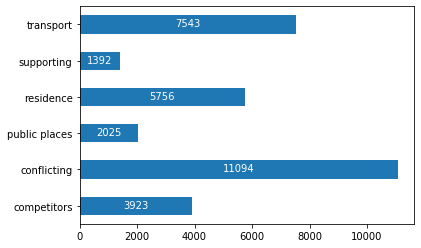

In [21]:
def barh(df, c, d):
    ax = df[[c]].groupby(c).size().plot(kind='barh')
    for p in ax.patches:
        ax.annotate(np.round(p.get_width(), decimals=0), 
                    (p.get_x()+p.get_width()/2., p.get_y()), 
                    ha='center', va='center', xytext=(0, 10),
                    color='#ffffff',
                    textcoords='offset points')
        ax.set_ylabel(None)

barh(df_venues, 'category', 0)

### Chicago Demographics Data <a name="chicago-demographics-data"></a>

Chicago demographics data is published on a third-party web site and has a hierarchical structure: the main page, child pages for every neighborhood, and sub-pages with actual demographic data.  
The data source does not provide any API, so to retrieve needed information safely and don't introduce an overhead, a considerable time delay between pages retrieval needs to be set.  
The retrieval process will start by getting the main page with the help of the `requests` module. Predefined `XPaths` expression will direct it to look for community dataset links at the proper place in `HTML` document model structure (`lxml` module).

In [22]:
# import all required modules for this section
import requests
from lxml import html
import json
import time
#!pip install flatten_json
from flatten_json import flatten
import pandas as pd
from os import path
from tqdm.notebook import trange, tqdm
import numpy as np
from numba import jit, cuda
from timeit import default_timer as timer 
from io import StringIO

pd.set_option('display.max_columns', None) # display all columns

In [23]:
demographics_data_file = "demographics_data.csv"

if path.exists(demographics_data_file):
    # load data from already composed file
    demographics_community = pd.read_csv(demographics_data_file, sep='|')
else:
    # retrieve demographics data
    source_page = requests.get('https://datahub.cmap.illinois.gov/dataset/community-data-snapshots-raw-data')
    tree = html.fromstring(source_page.content)
    data_file_link = tree.xpath('//section[@id="dataset-resources"]/ul//a[@title="CSV table: Chicago Community Area (CCA) CDS data"]/parent::li/div/ul/li[2]/a/@href')
    if len(data_file_link) > 0:
        data_file_link = data_file_link[0]
        source_page = requests.get(data_file_link)
        demographics_community = pd.read_csv(StringIO(source_page.content.decode("utf-8")), sep=',')
        demographics_community.to_csv(demographics_data_file, sep='|', index=False)
    else:
        raise ValueError(f'Can\'t find a link to the data file. try visit {source_page} and ajust x-path correspondingly.')
# link to fields description is availbale at https://datahub.cmap.illinois.gov/dataset/community-data-snapshots-raw-data
columns_scope = ['GEOG', #Community Name
                 'TOT_POP', #Total Population 
                 'UND19', 'A20_34', 'A35_49', 'A50_64', 'A65_74','A75_84','OV85', 'MED_AGE', # Age Cohorts
                 'WHITE', 'HISP', 'BLACK', 'ASIAN', 'OTHER', # Race and Ethnicity
                 'IN_LBFRC', 'EMP', 'UNEMP', 'NOT_IN_LBFRC', # Employment Status
                 'WORK_AT_HOME', 'TOT_COMM', 'DROVE_AL','CARPOOL', 'TRANSIT', 'WALK_BIKE', 'COMM_OTHER', # Mode of Travel to Work
                 'NO_VEH', 'ONE_VEH', 'TWO_VEH', 'THREEOM_VEH', # Vehicles Available
                 'LT_HS', 'HS', 'SOME_COLL', 'ASSOC', 'BACH', 'GRAD_PROF', # Educational Attainment
                 'INC_LT_25K', 'INC_25_50K', 'INC_50_75K', 'INC_75_100K', 'INC_100_150K', 'INC_GT_150', 'MEDINC', # Household Income
                 # 'H_Cost_Typical', 'T_Cost_Typical', 'HT_Cost_Typical', 'H_Cost_Mod', 'T_Cost_Mod', 'HT_Cost_Mod', # Housing & Transportation (H+T) Costs, Percent of Income per Household
                 # 'WALKSCORE', # Walk Score
                 'highly_walkable_pop_pct', 'highly_walkable_emp_pct' 
                ]
demographics_community = demographics_community[columns_scope]
demographics_community.rename({'GEOG':'community'}, axis=1, inplace=True)
demographics_community['community'] = demographics_community.apply(lambda row: row['community'].upper(), axis=1)
demographics_community.head()

,community,TOT_POP,UND19,A20_34,A35_49,A50_64,A65_74,A75_84,OV85,MED_AGE,WHITE,HISP,BLACK,ASIAN,OTHER,IN_LBFRC,EMP,UNEMP,NOT_IN_LBFRC,WORK_AT_HOME,TOT_COMM,DROVE_AL,CARPOOL,TRANSIT,WALK_BIKE,COMM_OTHER,NO_VEH,ONE_VEH,TWO_VEH,THREEOM_VEH,LT_HS,HS,SOME_COLL,ASSOC,BACH,GRAD_PROF,INC_LT_25K,INC_25_50K,INC_50_75K,INC_75_100K,INC_100_150K,INC_GT_150,MEDINC,highly_walkable_pop_pct,highly_walkable_emp_pct
0,ALBANY PARK,51992,13299,14031,11658,8134,2603,1573,694,33.665733,15608,24927,2401,7536,1520,29224,27098,2060,12118,919,25715,13090,2222,8606,1548,249,3289,7630,4204,1440,7441,8478,5094,1843,7581,4043,3508,3664,3032,2193,2326,1840,58128.20513,1.000000,1.000000
1,ARCHER HEIGHTS,13142,4017,2827,2925,1818,970,323,261,33.354392,2213,10181,115,581,52,6561,5956,605,3310,109,5659,3638,741,988,262,30,613,1571,1135,575,2357,3103,1415,309,762,239,880,1197,769,385,520,143,46632.12435,1.000000,0.796716
2,ARMOUR SQUARE,13455,2634,2816,2376,2522,1540,1097,470,43.833739,1728,538,1218,9832,138,6620,5849,772,4960,183,5492,1984,934,1138,1265,170,2223,2053,788,143,3351,3043,944,391,1397,869,2496,1038,599,316,549,210,26466.21622,1.000000,1.000000
3,ASHBURN,43792,12999,8377,9200,8567,3031,999,619,35.872483,4745,16924,20837,315,971,22287,19383,2904,11054,409,18354,13110,2296,2777,44,127,984,4284,4943,2771,4202,8428,6463,2617,3727,1983,1988,2489,2903,2080,2393,1129,66560.12658,0.792998,0.621943
4,AUBURN GRESHAM,46278,11696,9176,7871,9857,3810,2966,902,39.774642,324,862,44435,143,514,20714,16330,4376,16411,697,15311,9475,1136,4388,200,112,5216,7484,3485,926,5224,9744,9357,2187,3003,1828,7036,4348,2714,1404,1151,458,31694.19134,0.983347,0.995529


### Data consolidation <a name="data-consolidation"></a>

Tasks of data consolidation:
* Venue-community resolution
* Community scope reconciliation
* Put data together

#### Venue-community resolution <a name="venue-community-resolution"></a>

Each venue received from Foursquare Places API must linked to corresponding community. The data source lacks this information, therefore it must be done separately to filter out venues that do not belong to Chicago area, but were picked earlier due to the selected approach of venues retrieval.

In [24]:
# !conda install -c conda-forge shapely
# !pip install shapely
from shapely.geometry import shape, Point

In [25]:
def which_neighborhood(lng, lat, id, category)->list:
    point = Point(lng, lat)
    res = list()
    
    for feature in geo_json['features']:
        polygon = shape(feature['geometry'])
        if polygon.contains(point):
            res.append({'id': id,
                        'category': category,
                        'community': feature['properties']['community'],
                        'shape_area': feature['properties']['shape_area'],
                        'area_numbe': feature['properties']['area_numbe']})
    return res

In [26]:
venues_location_file = 'venues_location.json'

df_venues_neighborhoods = pd.DataFrame()

if path.exists(venues_location_file):
    # load data from already composed file
    df_venues_neighborhoods = pd.read_json(venues_location_file)
    for it_column in df_venues_neighborhoods.columns:
        if it_column in ['index', 'level_0']:
            df_venues_neighborhoods.drop(it_column, axis=1, inplace=True)
    # replace NaN with None
    for it_column in df_venues_neighborhoods.columns:
        df_venues_neighborhoods[it_column]=np.where(df_venues_neighborhoods[it_column].isnull(), None, df_venues_neighborhoods[it_column])    
else:
    # set up progress bar for a long lasting operation
    pbar = tqdm()
    pbar.reset(total=df_venues.shape[0])

    for idx, row in df_venues.iterrows():
        pbar.update()
        res = which_neighborhood(row['lng'], row['lat'], 
                                 row['id'], row['category'])
        if len(res) > 0:
            df_venues_neighborhoods = df_venues_neighborhoods.append(res)

    # removing duplicated ids within a category
    df_venues_neighborhoods.drop_duplicates(subset=['id', 'category'], 
                                            keep='last',
                                            inplace=True)
    
    # store retrieved data
    df_venues_neighborhoods.reset_index(inplace=True)
    for it_column in df_venues_neighborhoods.columns:
        if it_column in ['index', 'level_0']:
            df_venues_neighborhoods.drop(it_column, axis=1, inplace=True)
    df_venues_neighborhoods.to_json(venues_location_file)
    print(f'Venues location are stored to {venues_location_file}')

In [27]:
df_venues_neighborhoods.shape

(24382, 5)

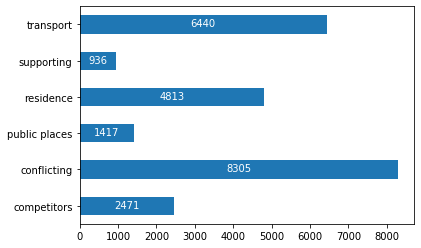

In [28]:
barh(df_venues_neighborhoods, 'category', 0)

In [29]:
if df_venues_neighborhoods.shape[0] == df_venues_neighborhoods.drop_duplicates(subset=['id', 'category']).shape[0]:
    print(f'no ambiguous resolution. total records: {df_venues_neighborhoods.shape[0]}')
else:
    print('some venues belong to more than one neighborhood!')

no ambiguous resolution. total records: 24382


In [30]:
# filter out all venues out of Chicago (via communities)
df_venue_c = pd.merge(df_venues, 
                      df_venues_neighborhoods[['id', 'community', 
                                               'shape_area', 'area_numbe']], 
                      how='inner', on='id')

x = list()
y = list()
for it_lng, it_lat in zip (df_venue_c['lng'].to_numpy(), df_venue_c['lat'].to_numpy()):
    x_, y_ = C.lonlat_to_xy([it_lng, it_lat])
    x.append(x_)
    y.append(y_)

df_venue_c['x'] = x
df_venue_c['y'] = y

In [31]:
df_venue_c.head()

,id,name,lat,lng,category,primary_category,raw_venue_object,originating_id,community,shape_area,area_numbe,x,y
0,3071c2b1afe536046e8d50d181ff96de,CTA Bus Stop - 119th & Vincennes,41.6774,-87.673,transport,4bf58dd8d48988d1fe931735,"{'id': '4ede7ce4e5fa78b172ee8e3b', 'name': 'CT...",4ede7ce4e5fa78b172ee8e3b,MORGAN PARK,9.18773e+07,75,443980.017371,4.614174e+06
1,6a011082148cf21c25180938b9966cc0,Metra - Racine,41.674,-87.6521,transport,4bf58dd8d48988d129951735,"{'id': '4f2040e0e5e8df85ac3ab23e', 'name': 'Me...",4f2040e0e5e8df85ac3ab23e,WEST PULLMAN,9.93652e+07,53,445722.313936,4.613792e+06
2,9f0963eac1575a489b23f69acd840fa0,SP+ Parking,41.6779,-87.6722,transport,4c38df4de52ce0d596b336e1,"{'id': '57b62860498eebea25736cb6', 'name': 'SP...",57b62860498eebea25736cb6,MORGAN PARK,9.18773e+07,75,444053.484653,4.614231e+06
3,344532be3866c39e709b392a352d83bf,CTA Bus Stop - 119th & Vincennes,41.6805,-87.6658,transport,4bf58dd8d48988d1fe931735,"{'id': '4ede7c1f0e61d46adccd510d', 'name': 'CT...",4ede7c1f0e61d46adccd510d,MORGAN PARK,9.18773e+07,75,444583.140287,4.614519e+06
4,7efbca793216baf0a2732b71bf5dce3f,119th & Ashland,41.682,-87.6575,transport,4bf58dd8d48988d1f9931735,"{'id': '4de56cea2271f377c2932c86', 'name': '11...",4de56cea2271f377c2932c86,WEST PULLMAN,9.93652e+07,53,445276.747521,4.614676e+06


#### Communities scope reconciliation  <a name="communities-scope-reconciliation"></a>

Comparison of communities naming identified two discrepancies between Chicago GEO json and Chicago Demographics data: the former was fixed by renaming `LOOP` and `OHARE` to `THE LOOP` and `O’HARE` correspondingly

In [32]:
def list_diff(l1, l2)->list:
    l1_diff = sorted(list(set([it for it in l1 if it not in l2])))
    l2_diff = sorted(list(set([it for it in l2 if it not in l1])))
    return [l1_diff, l2_diff]

In [33]:
def check_communities_diff()->list:
    diff = list_diff(get_all('$.features[*].properties.community', geo_json), 
                     demographics_community.community.to_list())
    return diff
diff = check_communities_diff()
print(diff)

[['LOOP', 'OHARE'], ["O'HARE", 'THE LOOP']]


In [34]:
# need to fix naming of only two communities
d = {'type': get_all('$.type', geo_json)}
l = list()

n_map = {'LOOP': 'THE LOOP', 'OHARE': 'O\'HARE'}

for it in geo_json['features']:
    community = get_first('$.properties.community', it)
    if community in diff[0]:
        it['properties']['community'] = n_map[community]
    l.append(it)
d['features'] = l
geo_json = d

In [35]:
# checking once again
print(check_communities_diff())

[[], []]


In [36]:
# update corresponding records in df_venue_c
for key, val in n_map.items():
    df_venue_c['community'] = df_venue_c['community'].apply(lambda x: x if x != key else val)

#### Put data together  <a name="put-data-together"></a>

At this point we have collected and pre-processed: 
* Chicago venues by category groups and linked them to corresponding community
* Demographics data per community
* GEO json with fixed naming

What is a common scale for different communities of the same city in the context of business goal? Basically, there are two of them: average venue category density per community and venue category distance per community. To calculate the averages following steps were done for each Chicago community area to form an area grid:
* get community boundaries to obtain min, max latitude and longitude
* find community center and place first 300x300m rectangular polygon
* fill community area with adjacent 300x300m rectangular polygon areas in all directions from area center unless border is crossed
* extend coverage if at least one of polygon vertices belongs to the current community area

Latitude, longitude conversion to UTM coordinates was done for zone 16N. This corresponds to Chicago longitude.

In [37]:
class GridGenerator:
    def __init__(self, nw:C, se:C, center:C, area_shape:list):
        self.nw = nw
        self.se = se
        self.center = center
        self.area_shape = area_shape
        self.grid_c = list()
        self.grid_a = list()
        self.grid_b = list()
        self.grid_i = list()
    
    def expand_x(self, y:float, step_west:float, step_east:float):
            #print(f'self.center.x={self.center.x}')
            #print(f'self.nw.x={self.nw.x}')
            #print(f'step_west={step_west}')
            
            #print(f'self.center.x={self.center.x}')
            #print(f'self.se.x={self.se.x}')
            #print(f'step_east={step_east}')
            
            for west in np.arange(self.center.x, 
                                  self.nw.x + step_west, # to ensure full coverage
                                  step_west):
                c = C(x = west, y = y)
                #print(f'WEST={c}')
                self.grid_c.append(c)
            for east in np.arange(self.center.x, 
                                  self.se.x + step_east, # to ensure full coverage
                                  step_east):
                c = C(x = east, y = y)
                #print(f'EAST={c}')
                self.grid_c.append(c)
    
    def calculate_grid_c(self, step:float):
        step_north = (-abs(step) if self.center.y > self.nw.y else step)
        step_south = (-abs(step) if self.center.y > self.se.y else step)
        step_west = (-abs(step) if self.center.x > self.nw.x else step)
        step_east = (-abs(step) if self.center.x > self.se.x else step)
        
        for north in np.arange(self.center.y,
                               self.nw.y + step_north, # to ensure full coverage
                               step_north):
            self.expand_x(y=north, step_west=step_west, step_east=step_east)
        
        for south in np.arange(self.center.y,
                               self.se.y + step_south, # to ensure full coverage
                               step_south):
            self.expand_x(y=south, step_west=step_west, step_east=step_east)
        
        self.grid_c = list(set(self.grid_c)) # remove duplicates
        
        updated_grid_c = list()
        
        for c in self.grid_c:
            # calculate area edges
            def calculate_edges(c, divider=2):
                c_nw = C(x=c.x + step_west/divider, y=c.y + step_north/divider)
                c_ne = C(x=c.x + step_east/divider, y=c.y + step_north/divider)
                c_sw = C(x=c.x + step_west/divider, y=c.y + step_south/divider)
                c_se = C(x=c.x + step_east/divider, y=c.y + step_south/divider)
                return c_nw, c_ne, c_sw, c_se
            
            c_nw, c_ne, c_sw, c_se = calculate_edges(c)
            #c_nw = rndll(c_nw)
            #c_ne = rndll(c_ne)
            #c_sw = rndll(c_sw)
            #c_se = rndll(c_se)

            # print(f'nw={c_nw}\nne={c_ne}\nse={c_se}\nsw={c_sw}\n-----------------')
            
            # check at least one edge belongs to the shape
            def belongs_to_shape(c:C)->bool:
                point = Point(c.lon, c.lat)
                polygon = shape(self.area_shape)
                if polygon.contains(point):
                    return True
                return False
            
            # print(belongs_to_shape(c_nw))
            # print(belongs_to_shape(c_ne))
            # print(belongs_to_shape(c_sw))
            # print(belongs_to_shape(c_se))
            res = [belongs_to_shape(c_nw), belongs_to_shape(c_ne),
                   belongs_to_shape(c_sw), belongs_to_shape(c_se)]
            area_id = hashlib.md5('|'.join([str(self.center), str(c_nw), str(c_ne), str(c_se), str(c_sw)]).encode('utf-8')).hexdigest()

            if True in res:                
                # print(f'c_nw= {c_nw.lon}; {c_nw.lat}')
                # print(f'c_ne= {c_ne.lon}; {c_ne.lat}')
                self.grid_a.append([c_nw, c_ne, c_se, c_sw]) # counter clockwise rectangular area
                self.grid_b.append(True if [True]*4 == res else False)
                self.grid_i.append(area_id)
                updated_grid_c.append(c)
            else:
                # to prevent situation when corners don't belong to the 
                # community area, but there is still an overlap
                for divider in range (3, 20):
                    c_nw1, c_ne1, c_sw1, c_se1 = calculate_edges(c, divider)
                    if True in [belongs_to_shape(c_nw1), belongs_to_shape(c_ne1),
                                belongs_to_shape(c_sw1), belongs_to_shape(c_se1)]:                
                            self.grid_a.append([c_nw, c_ne, c_se, c_sw]) # counter clockwise rectangular area
                            self.grid_b.append(False) # assumed as "partially belongs to the community"
                            self.grid_i.append(area_id)
                            updated_grid_c.append(c)
                            break
        
        self.grid_c = updated_grid_c[:]

In [38]:
grid_data_file = "grid_data.json"
grid_data = dict()

if path.exists(grid_data_file):
    # load data from already composed file
    with open(grid_data_file) as infile:
        grid_data = infile.read()
        grid_data = jsonpickle.decode(grid_data)
else:
    pbarc = tqdm(desc='Communities')
    pbarc.reset(total=len(df_n_aggr['community'].to_list()))
    for it_community in df_n_aggr['community'].to_list():
        # if it_community != 'WEST RIDGE':
        #    continue
        coordinates = get_all("$.features[?properties.community='" + it_community.replace("'", "\\'") + "'].geometry.coordinates[*]", geo_json)
        geometry = get_first("$.features[?properties.community='" + it_community.replace("'", "\\'") + "'].geometry", geo_json)

        lng=list(); lat=list()
        flatten_geo_list(coordinates, lng, lat)        

        area_lat_max=max(lat); area_lat_min=min(lat)
        area_lng_max=max(lng); area_lng_min=min(lng) 
        # print(f'Considered area:\narea_lng_max={area_lng_max}, area_lat_max={area_lat_max}\narea_lng_min = {area_lng_min},  area_lat_min = {area_lat_min}')
        c_b_nw = C(lon=area_lng_min, lat=area_lat_max) # rough community boundary north west
        c_b_se = C(lon=area_lng_max, lat=area_lat_min) # rough community boundary south east
        # print(f'c_b_nw:\n{c_b_nw}')
        # print(f'c_b_se:\n{c_b_se}')

        c_center = calculate_area_center(c_b_nw, c_b_se)
        # print(f'Community center point:\n{c_center}')

        #c_b_nw = rndll(c_b_nw) 
        #c_b_se = rndll(c_b_se)
        #c_center = rndll(c_center)
        #print(c_b_nw)
        #print(c_b_se)
        #print(c_center)

        grid = GridGenerator(nw=c_b_nw, se=c_b_se, center=c_center, area_shape=geometry)
        grid.calculate_grid_c(300.0)
        grid_data[it_community] = {'areaCenter': c_center, 
                                   'centroids': grid.grid_c, 
                                   'areas_id': grid.grid_i,
                                   'areas': grid.grid_a,
                                   'belongs_completely': grid.grid_b}
        pbarc.update() 

    # store retrieved data
    with open(grid_data_file, 'w') as outfile:
        json.dump(json.loads(jsonpickle.encode(grid_data)), outfile, indent=2)

In [39]:
# form data frame with all required information for each grid area
# information is redundant, but convenient to be accessed to and 
# is not supposed to to changed
l = list()
for key, value in grid_data.items():
    for c, a, i, b in zip(value['centroids'], value['areas'], value['areas_id'], value['belongs_completely']):
        l.append({'community': key,
                  'areaCenter': value['areaCenter'],
                  'centroid': c,
                  'centroid_x': c.x,
                  'centroid_y': c.y,
                  'centroid_lon': c.lon,
                  'centroid_lat': c.lat,                  
                  'area': a,
                  'area_id': i,
                  'area0': a[0], 'area1': a[1], 'area2': a[2], 'area3': a[3],
                  'belongs_completely': b})
df_grid = pd.DataFrame(l)
df_grid.head()

,community,areaCenter,centroid,centroid_x,centroid_y,centroid_lon,centroid_lat,area,area_id,area0,area1,area2,area3,belongs_completely
0,ALBANY PARK,x = 440228.56303551316;\ty = 4646533.183856498...,x = 440528.56303551316;\ty = 4646533.183856498...,440528.563036,4.646533e+06,-87.717746,41.968547,[x = 440378.56303551316;\ty = 4646683.18385649...,5cb2f51a8a8c529efe8f0550dde25486,x = 440378.56303551316;\ty = 4646683.183856498...,x = 440678.56303551316;\ty = 4646683.183856498...,x = 440678.56303551316;\ty = 4646383.183856498...,x = 440378.56303551316;\ty = 4646383.183856498...,True
1,ALBANY PARK,x = 440228.56303551316;\ty = 4646533.183856498...,x = 441728.56303551316;\ty = 4646233.183856498...,441728.563036,4.646233e+06,-87.703235,41.965935,[x = 441578.56303551316;\ty = 4646383.18385649...,e461fd1e02448577c47013560d63c5e9,x = 441578.56303551316;\ty = 4646383.183856498...,x = 441878.56303551316;\ty = 4646383.183856498...,x = 441878.56303551316;\ty = 4646083.183856498...,x = 441578.56303551316;\ty = 4646083.183856498...,True
2,ALBANY PARK,x = 440228.56303551316;\ty = 4646533.183856498...,x = 442028.56303551316;\ty = 4646233.183856498...,442028.563036,4.646233e+06,-87.699615,41.965957,[x = 441878.56303551316;\ty = 4646383.18385649...,0a4a5bbaffb085b9054dda30b08cfc5f,x = 441878.56303551316;\ty = 4646383.183856498...,x = 442178.56303551316;\ty = 4646383.183856498...,x = 442178.56303551316;\ty = 4646083.183856498...,x = 441878.56303551316;\ty = 4646083.183856498...,False
3,ALBANY PARK,x = 440228.56303551316;\ty = 4646533.183856498...,x = 439928.56303551316;\ty = 4646833.183856498...,439928.563036,4.646833e+06,-87.725017,41.971204,[x = 439778.56303551316;\ty = 4646983.18385649...,ae6cf0ff44d1a18005a18d93812569d3,x = 439778.56303551316;\ty = 4646983.183856498...,x = 440078.56303551316;\ty = 4646983.183856498...,x = 440078.56303551316;\ty = 4646683.183856498...,x = 439778.56303551316;\ty = 4646683.183856498...,True
4,ALBANY PARK,x = 440228.56303551316;\ty = 4646533.183856498...,x = 441128.56303551316;\ty = 4646533.183856498...,441128.563036,4.646533e+06,-87.710505,41.968592,[x = 440978.56303551316;\ty = 4646683.18385649...,bbbda147fc2c891ee769dffdc3d1a9f5,x = 440978.56303551316;\ty = 4646683.183856498...,x = 441278.56303551316;\ty = 4646683.183856498...,x = 441278.56303551316;\ty = 4646383.183856498...,x = 440978.56303551316;\ty = 4646383.183856498...,True


In [40]:
df_grid.shape

(8547, 14)

Venues allocation by communities can be obtained as cartesian product of venues and grid areas with consequent filtering: rough and precise. The former was required to reduce population of the precise filtering and was done on GPU in batches due to the high volumes (200M+). Precise check is necessary to avoid false positive allocations because of polygonal area shape.
As it was intended some venues were simultaneously allocated to more than one community which means that they are reachable from multiple communities simultaneously within 300x300m area.

In [41]:
def cartesian_product_basic(left, right):
    return (left.assign(key=1).merge(right.assign(key=1), on='key').drop('key', 1))

In [42]:
# rough check
@jit(nopython=True)
def belongs_to_area(v_x, v_y, area_max_x, area_min_x, area_max_y, area_min_y):
    iterations = v_x.shape[0]
    belongs = np.zeros((iterations,))
    for it_v_x, it_v_y, it_area_max_x, it_area_min_x, it_area_max_y, it_area_min_y, it in zip (v_x, v_y, area_max_x, area_min_x, area_max_y, area_min_y, range(iterations)):
        if (it_v_x >= it_area_min_x) and (it_v_x <= it_area_max_x) and (it_v_y >= it_area_min_y) and (it_v_y <= it_area_max_y):
            belongs[it] = 1
    return belongs

venues_on_grid_file = 'venues_on_grid.csv'

if path.exists(venues_on_grid_file):
    df_venue_area = pd.read_csv(venues_on_grid_file, sep='|')
else:
    df_grid_coord = df_grid[['area_id', 'area']].copy(deep=True)
    areas = df_grid.area.to_list()
    for i in range (0,4):
        col = 'area' + str(i)
        df_grid_coord[col + '_x'] = df_grid[col].apply(lambda r: r.x)
        df_grid_coord[col + '_y'] = df_grid[col].apply(lambda r: r.y)

    df_grid_coord['area_max_x'] = df_grid_coord.apply(lambda row: max([row['area'+str(i)+'_x'] for i in range (0,4)]), axis=1)
    df_grid_coord['area_min_x'] = df_grid_coord.apply(lambda row: min([row['area'+str(i)+'_x'] for i in range (0,4)]), axis=1)
    df_grid_coord['area_max_y'] = df_grid_coord.apply(lambda row: max([row['area'+str(i)+'_y'] for i in range (0,4)]), axis=1)
    df_grid_coord['area_min_y'] = df_grid_coord.apply(lambda row: min([row['area'+str(i)+'_y'] for i in range (0,4)]), axis=1)
    # -------------------------------------------
    # -------------------------------------------
    start = timer()
    df_venue_area = pd.DataFrame()
    for category in  ['transport', 'public places', 'residence', 'competitors', 'conflicting', 'supporting']:
        df = cartesian_product_basic(df_venue_c[df_venue_c.category==category][['id','x','y','lat','lng']], 
                                     df_grid_coord[['area_id','area_max_x', 'area_min_x', 'area_max_y', 'area_min_y',
                                                    'area']])

        r = belongs_to_area(df['x'].to_numpy(), df['y'].to_numpy(),
                            df['area_max_x'].to_numpy(), df['area_min_x'].to_numpy(), 
                            df['area_max_y'].to_numpy(), df['area_min_y'].to_numpy())

        # print(f'category {category}, size={str(df.shape[0])}')
        df['belongs'] = r
        df = df[df.belongs==1.0]

        # precise check to avoid false positive allocations
        belongs = []
        for idx, row in df.iterrows():        
            polygon = gm.Polygon([[it.lon, it.lat] for it in row.area])
            if polygon.contains(gm.Point(row.lng, row.lat)):
                belongs.append(True)
            else:
                belongs.append(False)
        df['allocated'] = belongs
        df_venue_area = df_venue_area.append(df)

    # print(timer() - start)
    df_venue_area = df_venue_area[df_venue_area.allocated==True][['id','area_id']]
    df_venue_area.rename({'id': 'venue_id'}, axis=1, inplace=True)
    df_venue_area.to_csv(venues_on_grid_file, sep='|', index=False)

In [43]:
df_venue_area

,venue_id,area_id
0,3071c2b1afe536046e8d50d181ff96de,6864dcdbc0743f73a18d0ffcdfa53ea7
1,6a011082148cf21c25180938b9966cc0,93bc406f94356ec9e8f86e59d05e5b8f
2,9f0963eac1575a489b23f69acd840fa0,6864dcdbc0743f73a18d0ffcdfa53ea7
3,344532be3866c39e709b392a352d83bf,f590bdf61cdb46706f01121267546ba8
4,7efbca793216baf0a2732b71bf5dce3f,edf3b333e1be604f8b29e66a1c2e8d78
...,...,...
29552,5ec2d9c83f931b397742d849ce724784,e3a53de16eca2117e0b8041cb2e6d902
29553,81aabc1d2958da07b4fbffb0a74d78be,c4591b8bcb055396d6598df3efe76bbc
29554,81aabc1d2958da07b4fbffb0a74d78be,1011775b900abd3be6dbe7084bf4df7c
29555,a91bc6cff73f15ee91dc95032eaa7a46,a8106072aba6c9371116c9037284d723


In [44]:
not_mapped = pd.merge(df_venue_c, df_venue_area, how='left', 
                      left_on='id', right_on='venue_id', indicator=True)
assert not_mapped[not_mapped['_merge'] != 'both'].shape[0] == 0

In [45]:
# display Chicago map with boundaries and grid (300mx300m) for each community
# grid is aligned with roughly calculated area shape, designed to overlap with 
# adjacentcommunities communities to do not miss near-the-edge areas
chicago_map = folium.Map(location=[chg_area_lat_min + (chg_area_lat_max-chg_area_lat_min)/2, 
                                   chg_area_lng_min + (chg_area_lng_max-chg_area_lng_min)/2], 
                         zoom_start=10)
folium.GeoJson(geo_json, name='geojson').add_to(chicago_map)

for key, val in grid_data.items():    
    # folium.Marker([c_b_nw.lat, c_b_nw.lon], popup='<i>c_b_nw</i>', icon=folium.Icon(color='red', icon='info-sign')).add_to(chicago_map)
    # folium.Marker([c_b_se.lat, c_b_se.lon], popup='<i>c_b_se</i>', icon=folium.Icon(color='red', icon='info-sign')).add_to(chicago_map)
    c_center = val['areaCenter']
    # folium.Marker([c_center.lat, c_center.lon], popup=f'<b>{key}</b>', icon=folium.Icon(color='green', icon='info-sign')).add_to(chicago_map)
    folium.CircleMarker([c_center.lat, c_center.lon], radius=1, color='black', 
                        fill=True, fill_color='black', fill_opacity=0.7,
                        popup=key).add_to(chicago_map)

    for p, id in zip(val['areas'] , val['areas_id']):
        #if id != '4399bea831644eafceb8aa33284906da':
        #    continue
        folium.Polygon([[x.lat, x.lon] for x in p], color='red', opacity=0.3, popup=id).add_to(chicago_map)
chicago_map

In [46]:
# visualize venues in WEST RIDGE community 
colours_map = {'transport': 'blue',
               'public places': 'grey',
               'competitors': 'red',
               'conflicting': 'orange',
               'supporting': 'green',
               'residence': 'lime'}

chicago_map = folium.Map(location=[chg_area_lat_min + (chg_area_lat_max-chg_area_lat_min)/2, 
                                   chg_area_lng_min + (chg_area_lng_max-chg_area_lng_min)/2], 
                         zoom_start=10)
folium.GeoJson(geo_json, name='geojson').add_to(chicago_map)

community_name = 'WEST RIDGE'
coordinates = get_all("$.features[?properties.community='" + community_name.replace("'", "\\'") + "'].geometry.coordinates[*]", geo_json)
geometry = get_first("$.features[?properties.community='" + community_name.replace("'", "\\'") + "'].geometry", geo_json)

lng=list(); lat=list()
flatten_geo_list(coordinates, lng, lat)        

area_lat_max=max(lat); area_lat_min=min(lat)
area_lng_max=max(lng); area_lng_min=min(lng)
c_b_nw = C(lat=area_lat_min, lon=area_lng_max)
c_b_se = C(lat=area_lat_max, lon=area_lng_min)

#folium.Marker([c_b_nw.lat, c_b_nw.lon], popup='<i>c_b_nw</i>', icon=folium.Icon(color='red', icon='info-sign')).add_to(chicago_map)
#folium.Marker([c_b_se.lat, c_b_se.lon], popup='<i>c_b_se</i>', icon=folium.Icon(color='red', icon='info-sign')).add_to(chicago_map)

for idx, row in df_grid[df_grid['community'] == community_name].iterrows():
    folium.Polygon([[x.lat, x.lon] for x in row['area']], color='red', opacity=0.3).add_to(chicago_map)
    
    folium.CircleMarker([row.centroid.lat, row.centroid.lon], radius=1, 
                        color='black', 
                        fill=True, popup=row['area_id'],
                        fill_color='black', 
                        fill_opacity=0.7).add_to(chicago_map)

for idx, row in df_venue_c[df_venue_c.community == community_name].iterrows():
    folium.CircleMarker([row.lat, row.lng], radius=10, 
                        color=colours_map[row.category], 
                        fill=True, popup=row['id'],
                        fill_color=colours_map[row.category], 
                        fill_opacity=0.7).add_to(chicago_map)

chicago_map

Calculation of average venue category density per community as a ratio of venue category count to number of grid cells within particular Chicago community

In [47]:
# df_venue_area.venue_id.value_counts()
df_venue_area[df_venue_area['venue_id'] == '2a449ebb649942a65cafbc4ad2b2f830']

,venue_id,area_id
6800,2a449ebb649942a65cafbc4ad2b2f830,568b169cae6a51b5f656390e7aa81d66
6801,2a449ebb649942a65cafbc4ad2b2f830,fcfc138c2c5d106d5358b5582b3b39de
6802,2a449ebb649942a65cafbc4ad2b2f830,6b7b092a8df8e0832cce843e1fdb6fd3
6803,2a449ebb649942a65cafbc4ad2b2f830,089cbe3a547981575d47eaea7a985c6c


In [48]:
df_venue_area_community = pd.merge(df_venue_area, df_grid[['community','area_id']],
                                   how='inner', on='area_id')
df_venue_area_community.rename(columns={'community':'community_actual'}, inplace=True)

df_venue_area_community = pd.merge(df_venue_area_community, df_venue_c[['id','category','community']],
                                   how='inner', left_on='venue_id', right_on='id')
df_venue_area_community.rename(columns={'community':'community_primary'}, inplace=True)
df_venue_area_community.drop(['id'], axis = 1, inplace = True, errors = 'ignore')

df_venue_area_community[df_venue_area_community['venue_id'] == '2a449ebb649942a65cafbc4ad2b2f830']

,venue_id,area_id,community_actual,category,community_primary
22518,2a449ebb649942a65cafbc4ad2b2f830,568b169cae6a51b5f656390e7aa81d66,LAKE VIEW,transport,NORTH CENTER
22519,2a449ebb649942a65cafbc4ad2b2f830,fcfc138c2c5d106d5358b5582b3b39de,LINCOLN SQUARE,transport,NORTH CENTER
22520,2a449ebb649942a65cafbc4ad2b2f830,6b7b092a8df8e0832cce843e1fdb6fd3,NORTH CENTER,transport,NORTH CENTER
22521,2a449ebb649942a65cafbc4ad2b2f830,089cbe3a547981575d47eaea7a985c6c,UPTOWN,transport,NORTH CENTER


In [49]:
# calculate density of (each category) per community
#     this calculation must be based on venue -> (comunity, area) counts as they can include adjacent areas from different communities

area_category_count = df_venue_area_community.groupby(by=['area_id', 'category']).size()
area_category_count = area_category_count.to_frame().reset_index().rename(columns={0:'venue_count'})

community_category_count = pd.merge(area_category_count, df_grid[['community','area_id']],
                                    how='inner', on='area_id')
community_category = community_category_count.groupby(by=['community', 'category']).sum().reset_index()

community_area_count = df_grid[['community','area_id']].groupby(by=['community']).size().to_frame().reset_index().rename(columns={0:'area_count'})
community_category = pd.merge(community_category, community_area_count, 
                              how='inner', on='community')
community_category['density'] = community_category['venue_count'] / community_category['area_count'] # venues per 300 sq m area of a community
community_category_density = community_category.pivot(index='community', columns='category', values='density')

In [50]:
community_category_density.head()

category,competitors,conflicting,public places,residence,supporting,transport
community,,,,,,
ALBANY PARK,0.439024,0.548780,0.134146,1.158537,0.097561,1.243902
ARCHER HEIGHTS,0.176471,0.470588,0.058824,0.073529,0.117647,0.308824
ARMOUR SQUARE,0.217391,0.717391,0.434783,0.239130,0.304348,0.565217
ASHBURN,0.076923,0.360947,0.082840,0.041420,0.029586,0.236686
AUBURN GRESHAM,0.069767,0.573643,0.077519,0.162791,0.069767,0.263566


Calculation of venue category distance for each community as Euclidian distance from area grid cell to closest venue of particular category, which belongs to this grid cell

In [51]:
# distance from each area center to closest (each category)
df_distance = pd.merge(df_venue_area, 
                       df_venue_c[['id', 'lat', 'lng', 'category']], 
                       how='inner', left_on='venue_id', right_on='id')
df_distance = pd.merge(df_distance, df_grid[['area_id', 'centroid']],
                       how='inner', on='area_id')

df_distance['area_center_distance'] = df_distance.apply(lambda row: calc_xy_distance(C(lat=row['lat'], lon=row['lng']), row['centroid']), axis=1)
df_distance.reset_index(inplace=True)

df_distance.head()

,index,venue_id,area_id,id,lat,lng,category,centroid,area_center_distance
0,0,3071c2b1afe536046e8d50d181ff96de,6864dcdbc0743f73a18d0ffcdfa53ea7,3071c2b1afe536046e8d50d181ff96de,41.6774,-87.673,transport,x = 444022.418664906;\ty = 4614130.800008807;\...,60.386253
1,1,9f0963eac1575a489b23f69acd840fa0,6864dcdbc0743f73a18d0ffcdfa53ea7,9f0963eac1575a489b23f69acd840fa0,41.6779,-87.6722,transport,x = 444022.418664906;\ty = 4614130.800008807;\...,104.861737
2,2,49fcc7f3d1a1736d55873c4d98bf0510,6864dcdbc0743f73a18d0ffcdfa53ea7,49fcc7f3d1a1736d55873c4d98bf0510,41.6781,-87.6727,conflicting,x = 444022.418664906;\ty = 4614130.800008807;\...,130.614638
3,3,44e10b1bb7db590f6ec6d3e56f96565f,6864dcdbc0743f73a18d0ffcdfa53ea7,44e10b1bb7db590f6ec6d3e56f96565f,41.6778,-87.6713,conflicting,x = 444022.418664906;\ty = 4614130.800008807;\...,139.118008
4,4,6a011082148cf21c25180938b9966cc0,93bc406f94356ec9e8f86e59d05e5b8f,6a011082148cf21c25180938b9966cc0,41.674,-87.6521,transport,x = 445780.0262892157;\ty = 4613788.283056369;...,57.851681


In [52]:
df_distance_min = df_distance[['area_id', 'category', 'area_center_distance']].groupby(by=['area_id', 'category']).min().reset_index()
df_distance_min = df_distance_min.pivot(index='area_id', columns='category', values='area_center_distance')
df_distance_min = pd.merge(df_distance_min, df_grid[['community','area_id']],
                           how='inner', on='area_id')
df_distance_min[df_distance_min['community'] == 'WEST RIDGE'].head(10)

,area_id,competitors,conflicting,public places,residence,supporting,transport,community
27,0180137c4b4b97ffc981fa6d807cd432,NaN,74.989431,NaN,NaN,NaN,NaN,WEST RIDGE
28,0181b08d83cbdad58560d84043e726dd,NaN,114.527762,NaN,84.306120,NaN,60.471214,WEST RIDGE
61,03448309d537a7ea09b7b33eeafd3fe0,NaN,102.305196,NaN,33.285950,NaN,142.147547,WEST RIDGE
113,06c57fe2b6a33cb101b336068037c722,94.248909,NaN,NaN,100.852455,NaN,88.669067,WEST RIDGE
187,0a91e86d68075903848ecf3a6bd54b3e,146.844806,168.753362,NaN,103.514808,NaN,NaN,WEST RIDGE
211,0b3c45a319c5457c2798496f9a1cf492,NaN,NaN,NaN,NaN,NaN,126.252841,WEST RIDGE
281,0f820c72135cee0da7fe5a2f3c7fd52d,NaN,15.111498,NaN,NaN,NaN,21.421905,WEST RIDGE
295,1011775b900abd3be6dbe7084bf4df7c,NaN,NaN,NaN,127.708653,128.349032,75.775071,WEST RIDGE
360,13aaa45e8254daaab2f1c7c163c75769,103.431131,109.584972,NaN,NaN,NaN,89.507939,WEST RIDGE
468,1a6e432860356192d9c5ba519978b8c6,NaN,88.067840,NaN,NaN,NaN,94.037285,WEST RIDGE


Since missed values cannot be kept as is and have to be imputed somehow, I decided that the best way to do it was to find distance beyond boundaries of such grid cell areas. So cartesian product of areas with missed venue category and all venues of the same category were obtained to find minimal possible distance per area grid cell per category. This calculation was done on GPU to speed up the process

In [53]:
@jit(nopython=True)
def calculate_distance(v_x, v_y, c_x, c_y):
    iterations = v_x.shape[0]
    distance = np.zeros((iterations,))
    for it_v_x, it_v_y, it_c_x, it_c_y, it in zip (v_x, v_y, c_x, c_y, range(iterations)):
        dx = it_c_x - it_v_x
        dy = it_c_y - it_v_y
        distance[it] = math.sqrt(dx*dx + dy*dy)
    return distance

def adjacent_venues_by_category(category:str):
    df_adjacent_communities = df_venue_area_community.groupby('community_primary')['community_actual'].apply(list).to_frame().reset_index()
    df0 = pd.DataFrame()
    for idx, row in df_adjacent_communities.iterrows():
        extension = row['community_actual']
        df = df_venue_area_community[(df_venue_area_community['category'] == category) &
                                 (df_venue_area_community['community_primary'].isin(extension))][['venue_id', 'community_primary', 'category']]
        df['initial_community'] = row['community_primary']
        df0 = df0.append(df)
    return df0

distance_file = 'distance.csv'
df_min = pd.DataFrame()

if path.exists(distance_file):
    # load data from already composed file
    df_min = pd.read_csv(distance_file, sep='|')
    for it_column in df_min.columns:
        if it_column in ['index', 'level_0', 'Unnamed: 0']:
            df_min.drop(it_column, axis=1, inplace=True)
else:
    for category in  ['transport', 'public places', 'residence', 'competitors', 'conflicting', 'supporting']:
        df_areas_no_venue = pd.merge(df_distance_min[df_distance_min[category].isnull()][['area_id']].drop_duplicates(),
                                     df_grid[['area_id', 'community', 'centroid', 'centroid_x', 'centroid_y']], how='right', on='area_id')
        df_areas_no_venue[category] = category

        df_areas_no_venue = cartesian_product_basic(df_areas_no_venue, 
                                                    df_venue_area_community[(df_venue_area_community['category'] == category)][['venue_id', 'community_primary', 'category']])

        df_areas_no_venue = pd.merge(df_areas_no_venue, 
                                     df_venue_c[['id', 'lat', 'lng', 'x', 'y']],
                                     how='inner', left_on='venue_id', right_on='id')

        print(f'category: {category}, combinations: {df_areas_no_venue.shape[0]}')

        distance = calculate_distance(df_areas_no_venue['x'].to_numpy(), df_areas_no_venue['y'].to_numpy(),
                                      df_areas_no_venue['centroid_x'].to_numpy(), df_areas_no_venue['centroid_y'].to_numpy())

        df_areas_no_venue['distance'] = distance

        g = df_areas_no_venue.groupby(['area_id'])
        df_areas_no_venue['rank'] = g['distance'].rank(method='min')
        df_min = df_min.append(df_areas_no_venue[df_areas_no_venue['rank']==1][['area_id', 'community_primary', 'category', 'venue_id', 'distance', 'lng', 'lat', 'x', 'y', 'centroid', 'centroid_x', 'centroid_y']])

    # store retrieved data
    # fix data qualityissue: Same venue can appear multiple times under different names but same geo location)
    df_min.drop_duplicates(subset=['area_id', 'category'], keep='first', inplace=True)
    df_min.reset_index(inplace=True, drop=True)
    for it_column in df_min.columns:
        if it_column in ['index', 'level_0']:
            df_min.drop(it_column, axis=1, inplace=True)
    df_min = df_min[['area_id', 'community_primary', 'category', 'venue_id', 
                     'distance', 'lng', 'lat', 'x', 'y', 'centroid_x', 'centroid_y']]
    df_min.to_csv('distance.csv', sep='|')

In [54]:
df_min = df_min.pivot(index='area_id', columns='category', values='distance')
df_min.reset_index(inplace=True)

In [55]:
df_distance = pd.DataFrame()
for category in ['transport', 'public places', 'residence', 'competitors', 'conflicting', 'supporting']:
    columns = ['area_id', category]
    df = pd.concat([df_min[columns], df_distance_min[columns]]).sort_values([category]).drop_duplicates('area_id')
    df = pd.melt(df, id_vars=['area_id'], var_name=[category])
    df.rename({category:'category', 'value': 'distance'}, inplace=True, axis=1)
    df_distance = df_distance.append(df, ignore_index=True)

In [56]:
# all areas have populated distance to a corresponding venue category
assert df_distance[df_distance['distance'].isna()]['area_id'].shape[0] == 0

# all areas are covered
assert df_grid[~df_grid['area_id'].isin(df_distance['area_id'])].shape[0] == 0

In [57]:
df_distance = pd.merge(df_distance, df_grid[['area_id', 'community']],
                       how = 'inner', on='area_id')
df_distance.head(10)

,area_id,category,distance,community
0,47a606f0b708060f0a9796149ad487bb,transport,0.790049,WEST TOWN
1,47a606f0b708060f0a9796149ad487bb,public places,356.061992,WEST TOWN
2,47a606f0b708060f0a9796149ad487bb,residence,178.535659,WEST TOWN
3,47a606f0b708060f0a9796149ad487bb,competitors,102.335184,WEST TOWN
4,47a606f0b708060f0a9796149ad487bb,conflicting,118.658850,WEST TOWN
5,47a606f0b708060f0a9796149ad487bb,supporting,217.529628,WEST TOWN
6,fe1d0156af2a2da752a3b15b44b3144e,transport,1.254321,LOGAN SQUARE
7,fe1d0156af2a2da752a3b15b44b3144e,public places,182.068200,LOGAN SQUARE
8,fe1d0156af2a2da752a3b15b44b3144e,residence,82.522118,LOGAN SQUARE
9,fe1d0156af2a2da752a3b15b44b3144e,competitors,135.787428,LOGAN SQUARE


In [58]:
# average distance per community, category
community_category_distance = df_distance.groupby(by=['community', 'category']).agg(func='mean').reset_index().pivot(index='community', columns='category',values='distance')
community_category_distance[community_category_distance.index.isin(['WEST RIDGE', 'THE LOOP', 'ALBANY PARK'])]

category,competitors,conflicting,public places,residence,supporting,transport
community,,,,,,
ALBANY PARK,269.605149,317.099854,452.109839,166.124850,551.582775,184.619948
THE LOOP,117.839023,130.478823,265.548695,171.715404,205.577592,125.122677
WEST RIDGE,370.366112,265.272458,514.581730,241.431251,672.340682,202.503256


---

## Methodology <a name="methodology"></a>

### Exploratory Data Analysis <a name="exploratory-data-analysis"></a>

To identify optimal areas, we need to understand impact factors. So far average distance and average density were calculated, demographics data per community is also available.

Average density per community has greater number of strong correlations (>0.8), so it is reasonable to use average venue category density data set over average distance data set. Moreover, the latter one indicates a strong, but weaker than density data frame correlation between `conflicting`, `competitors`, `transport` and `residence` factors. Therefore, I focused efforts on the average density per community and demographics data set.

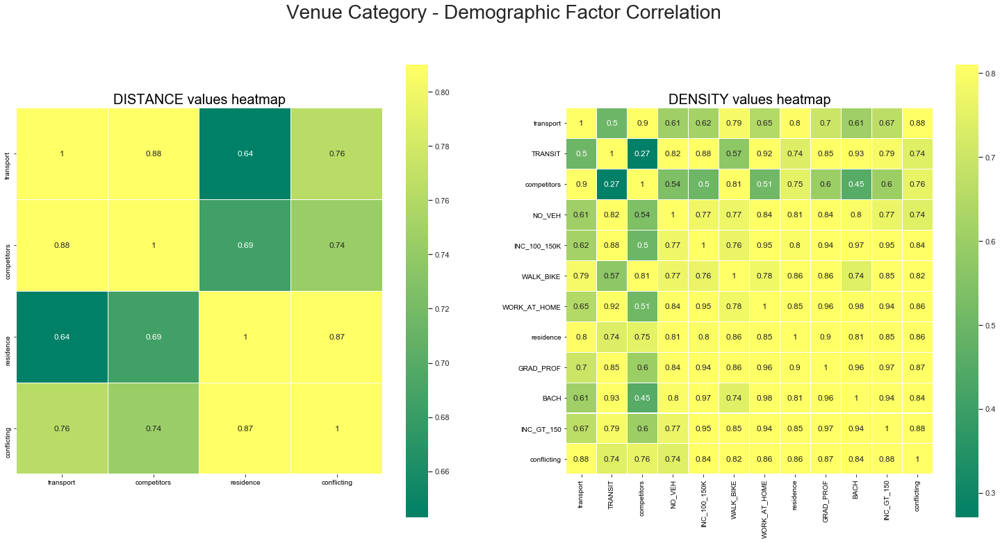

In [59]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

def calculate_heatmap(df_input:pd.DataFrame, strong_corr_coef:float):
    df = pd.merge(df_input, demographics_community, how='inner', on='community')
    corr = df.corr(method='pearson')
    basis_columns = ['transport', 'public places', 'residence', 'competitors', 'conflicting', 'supporting']
    factors = list()
    
    for column in basis_columns:
        it = corr[[column]].sort_values(by=[column], ascending = False)
        it = it[abs(it[column]) > strong_corr_coef] #strong positive (negative) linear relationship via a firm linear rule
        factors.extend(it.index.to_list())
    
    factors=list(set(factors))
    factors.remove('supporting') # no correlation, avoid empty columns, rows
    factors.remove('public places') # no correlation, avoid empty columns, rows
    cm = np.corrcoef(df[factors].values.T)
    
    return cm, factors

fig, ax = plt.subplots(1, 2, figsize = (26,12))
sns.set()
idx = 0
strong_corr_coef = 0.81
for df, title in zip([community_category_distance, community_category_density], ['DISTANCE values heatmap', 'DENSITY values heatmap']):
    cm, factors = calculate_heatmap(df, strong_corr_coef)
    sns.heatmap(cm, vmax=strong_corr_coef, linewidths=0.01, square=True, annot=True, cmap='summer',
                xticklabels=factors, annot_kws={'size':12}, yticklabels=factors, ax=ax[idx])
    ax[idx].set_title(title, fontsize='20')
    idx += 1
    plt.suptitle("Venue Category - Demographic Factor Correlation", fontsize='28')

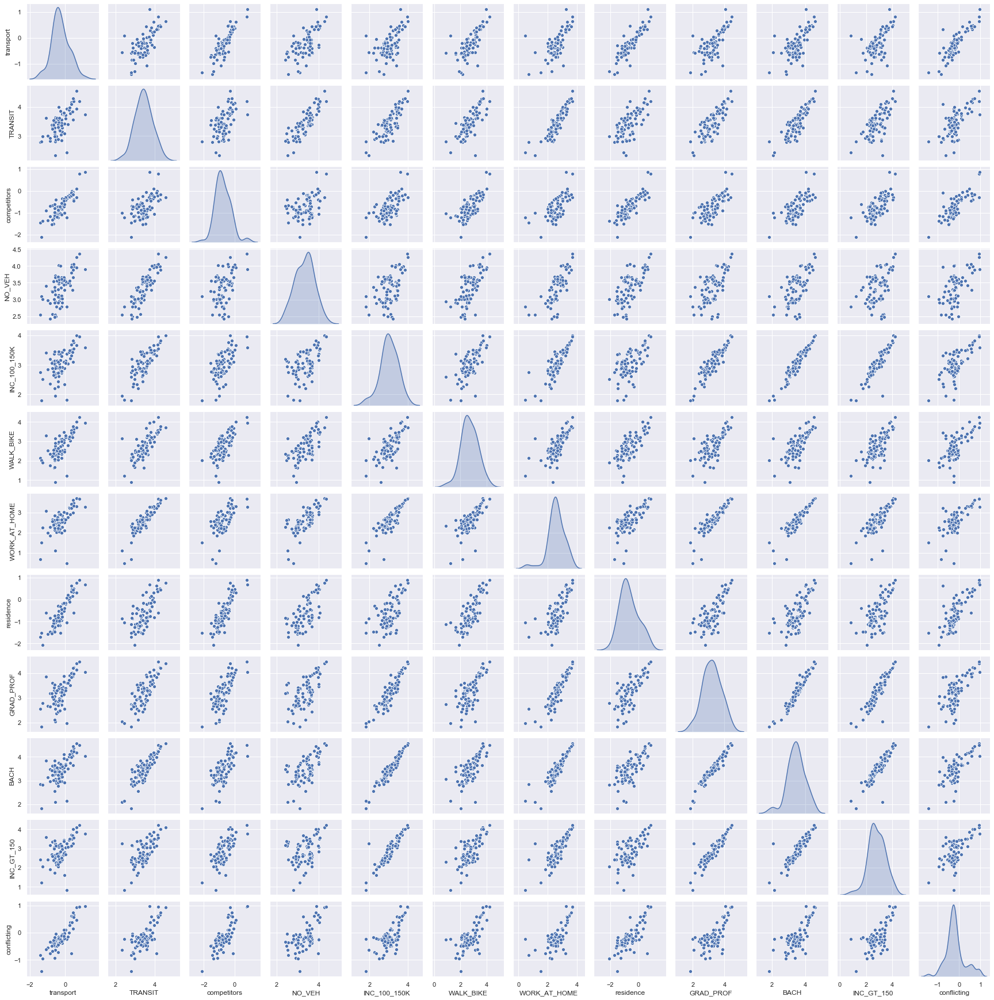

In [60]:
# fix zeros for log10 function
df = pd.merge(community_category_density, demographics_community, how='inner', on='community')
# columns = [it for it in df.columns if it != 'community'] 
# columns = ['competitors', 'transport', 'conflicting', 'residence', 'WALK_BIKE', 'NO_VEH', 'GRAD_PROF', 'BACH', 'INC_100_150K', 'INC_GT_150']
columns = factors

# avoid right-skewed distribution
for column in columns:
    imputed_value = value=df[df[column] != 0][column].mean()
    df.replace(to_replace={column:0}, value=imputed_value, inplace=True) # imputing zeroes with average value
    df[column] = np.log10(df[column]) 
sns.set()
sns.pairplot(df[columns], height = 2, kind ='scatter', diag_kind='kde')
plt.savefig("test.png", dpi=300)
plt.show()

Density heatmap in conjunction with the pairwise relationship plot (see below) allowed to bring following insights:
* `competitors` factor:
    * pair `competitors` - `transport` has strong correlation as it was initially thought. Venues of transport type (as defined at [Venue category](#venue-category)) acts as a primary factor of proper location for a gym
    * areas where people travel to work either by walk or bike (`WALK_BIKE`) is also a strong factor for having a `competitor` in particular area. Same time correlation between `competitors` and `NO_VEH` suggests previous one is more likely to be by choice.
    * good correlation also exists between `competitors` and `residence`, `conflicting`. To run business effectively, optimal location should be closer to `residence` rather than to `conflicting`
* `transport` factor:
    * correlation `transport` - `WALK_BIKE` suggests that the former looks like more bike than walk
    * expectedly, strong correlation between `transport` and `residence`, `transport` and `conflicting`
    * good correlation between `transport` and `GRAD_PROF`
* `conflicting` factor:
    * this factor has strong correlation with almost all selected demographics factors
    * `WORK_AT_HOME` factor has strong correlation with `conflicting`
    * strong correlation with `BACH` and `GRAD_PROF`. So it's more common within areas with higher number of Bachelors and Post Graduates
    * income `INC_100_150K`, `INC_GT_150` is also in a strong correlation with `conflicting`
* `supporting` and `public places` factors appeared to be uncorrelated with any other factor

Feature set above looks reasonable for further analysis, however, to address the business problem, I will go with unsupervised learning method – clustering. Clustering algorithms are designed to properly reduce number of points in a dataset, so it should fit the best here as identified number of areas for location is 8547 and it must be reduced to 25…50 to select manually from. Dimensionality reduction, such as PCA will not work here as after dimensionality reduction, there usually is not a particular meaning assigned to each principal component because the new components are just the new main dimensions of variation.

In [61]:
avg_category_count = pd.melt(community_category_density.reset_index(), id_vars=['community'],
                             value_vars = ['competitors', 'conflicting', 'public places', 
                                           'residence', 'supporting','transport'])
avg_category_count.rename({'value':'density_avg'}, axis=1, inplace=True)
avg_category_count.sort_values(by=['community','category'], inplace=True)

Composing data frame with detailed breakdown for each area with at least one competitor venue. It included information about area centroid, count of competitor venues, weight and rank. Weight is calculated as average density divided by competitor venues count (the smaller number of competitors the higher weight) and then ranked area within communities. Rank was turned into negative to make a way for the areas without any competitor venue and corresponding representation on the geo heatmap (otherwise blank areas would be filled on the heatmap and it would make it unreadable).

In [62]:
df_areas = pd.merge(area_category_count, 
                    df_grid[['area_id', 'community' ,'centroid_lon', 'centroid_lat']],
                    how = 'inner', on='area_id')
df_areas = pd.merge(df_areas, avg_category_count,
                    how='inner', on=['community', 'category'])
df_areas = df_areas[df_areas['category']=='competitors']
df_areas['weight'] = df_areas['density_avg'] / df_areas['venue_count']
# df_areas = df_areas[df_areas['community'] == 'WEST RIDGE'].copy(deep=True)
g = df_areas.groupby(['community'])
df_areas['rank'] = g['weight'].rank(method='dense', ascending=False)
df_areas['rank'] = df_areas['rank'] * (-1)
# df_areas[df_areas['community']=='RIVERDALE'][['weight']].drop_duplicates()
# df_areas[df_areas['community']=='WEST RIDGE'][['venue_count','rank']].drop_duplicates()

In [63]:
from folium.plugins import HeatMap, Fullscreen
chicago_map = folium.Map(location=[chg_area_lat_min + (chg_area_lat_max-chg_area_lat_min)/2, 
                                   chg_area_lng_min + (chg_area_lng_max-chg_area_lng_min)/2], 
                         zoom_start=10)
folium.GeoJson(geo_json, name='geojson').add_to(chicago_map)
folium.TileLayer('cartodbpositron').add_to(chicago_map)
HeatMap(df_areas[df_areas['category']=='competitors']
        [['centroid_lat','centroid_lon','rank']]).add_to(chicago_map)
Fullscreen().add_to(chicago_map)

In [64]:
# Heatmap with at least one competitor venue. It contains 1342 records.
chicago_map

Excluding those 1342 areas from entire grid

In [65]:
df_area_candidate = pd.merge(df_areas[['area_id']], df_grid,
                           how='right', on=['area_id'], indicator=True)
df_area_candidate = df_area_candidate[df_area_candidate['_merge']=='right_only']
df_area_candidate.shape

(7205, 15)

In [66]:
assert df_area_candidate.shape[0] + df_areas.shape[0] == df_grid.shape[0]

Too many candidates, the list needs to be reduced

In [67]:
df = pd.merge(df_area_candidate, 
              df_distance[df_distance['category']=='competitors'][['area_id', 'distance']],
              how='inner', on='area_id')

avg_competitor_distance = df[['distance']].mean().values[0]

df_area_candidate = pd.merge(df_area_candidate, 
                             df_distance[(df_distance['category']=='competitors') &
                                         (df_distance['distance'] > avg_competitor_distance)][['area_id']],
                             how='inner', on='area_id')
                             
df_area_candidate.shape

(2638, 15)

It still can be reduced by considering other venue categories

In [68]:
from folium.plugins import HeatMap, Fullscreen
chicago_map = folium.Map(location=[chg_area_lat_min + (chg_area_lat_max-chg_area_lat_min)/2, 
                                   chg_area_lng_min + (chg_area_lng_max-chg_area_lng_min)/2], 
                         zoom_start=10)
folium.GeoJson(geo_json, name='geojson').add_to(chicago_map)
folium.TileLayer('cartodbpositron').add_to(chicago_map)
HeatMap(df_area_candidate[['centroid_lat','centroid_lon']]).add_to(chicago_map)
Fullscreen().add_to(chicago_map)
chicago_map

Exploratory analysis indicated transport as a factor strongly correlated with competitors, therefore let's consider candidate areas with at least one transport venue

In [69]:
df_transport = pd.merge(area_category_count[area_category_count['category']=='transport'], 
                        df_grid[['area_id', 'community' ,'centroid_lon', 'centroid_lat']],
                        how = 'inner', on='area_id')
df_transport = pd.merge(df_transport, avg_category_count,
                        how='inner', on=['community', 'category'])
df_area_candidate = df_transport[df_transport['area_id'].isin(df_area_candidate.area_id)]
df_area_candidate.shape

(429, 7)

In [70]:
# visualizing 429 area candidates with at least one transport venue
from folium.plugins import HeatMap, Fullscreen
chicago_map = folium.Map(location=[chg_area_lat_min + (chg_area_lat_max-chg_area_lat_min)/2, 
                                   chg_area_lng_min + (chg_area_lng_max-chg_area_lng_min)/2], 
                         zoom_start=10)
folium.GeoJson(geo_json, name='geojson').add_to(chicago_map)
folium.TileLayer('cartodbpositron').add_to(chicago_map)
HeatMap(df_area_candidate[['centroid_lat','centroid_lon']]).add_to(chicago_map)
for idx, row in df_area_candidate.iterrows():
    folium.CircleMarker([row.centroid_lat, row.centroid_lon], radius=1, 
                    color='blue', 
                    fill=True, popup=row['community'],
                    fill_color='blue', 
                    fill_opacity=0.7).add_to(chicago_map)
Fullscreen().add_to(chicago_map)
chicago_map

### Clustering <a name="clustering"></a>

Clustering is done by community where previously identified 429 area candidates are located. Initialization method is `k-means++`. Results of clustering are visualized over the heatmap with candidate areas.  
Special handling (clustering imitation) was done for cases when a community contained either one or two area candidates. Such cases should have been dropped when acted in isolated environment, however I decided to keep them as they may become useful during next stage.

In [71]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.preprocessing import StandardScaler
# lon_lat = df_area_candidate[df_area_candidate['community']=='HUMBOLDT PARK'] [['centroid_lon', 'centroid_lat']].values
clustering = dict()
for community in df_area_candidate['community'].unique().tolist():
    #if community != 'LOWER WEST SIDE':
    #    continue
    community_lon_lat = df_area_candidate[df_area_candidate['community']==community][['centroid_lon', 'centroid_lat']].values
    # print(f'processing {community} with {community_lon_lat.shape[0]} records')
    scaler = StandardScaler()
    data = scaler.fit_transform(community_lon_lat)
    silhouette_vals = list()
    cluster_centers = list()
    km_labels = list()
    cluster_map = pd.DataFrame()
    k = range (2, community_lon_lat.shape[0])
    for kclusters in k:
        km = KMeans(n_clusters=kclusters, random_state=0)
        cluster_labels = km.fit_predict(data)
        cluster_center = [[cc[0], cc[1]] for cc in km.cluster_centers_]
        score = silhouette_score(data, cluster_labels)
        silhouette_vals.append(score)
        cluster_centers.append(cluster_center)
        km_labels.append(km.labels_)
        # print(f'{score} for {kclusters} clusters')
    if community_lon_lat.shape[0] > 2:
        optimal_index = silhouette_vals.index(max(silhouette_vals))
        optimal_clusters = [*k][optimal_index]
        clustering[community] = {'clusters': [*k], 
                                 'silhouette_vals': silhouette_vals,
                                 'data': scaler.inverse_transform(data),
                                 'optimal': {'clustersNumber': optimal_clusters,
                                             'clusterCenters': scaler.inverse_transform(cluster_centers[optimal_index]),
                                             'clusterLabels': km_labels[optimal_index]}
                                }
    else:
        # have to to introduce obvious clustering
        clustering[community] = {'clusters': [1, 2] if community_lon_lat.shape[0] == 2 else [1], 
                                 'silhouette_vals': None,
                                 'data': scaler.inverse_transform(data),
                                 'optimal': {'clustersNumber': community_lon_lat.shape[0],
                                             'clusterCenters': np.array([[row['centroid_lon'], row['centroid_lat']] for idx, row in df_area_candidate[df_area_candidate['community']==community].iterrows()]),
                                             'clusterLabels': np.array([0, 1] if community_lon_lat.shape[0] == 2 else [0])
                                            }
                                }

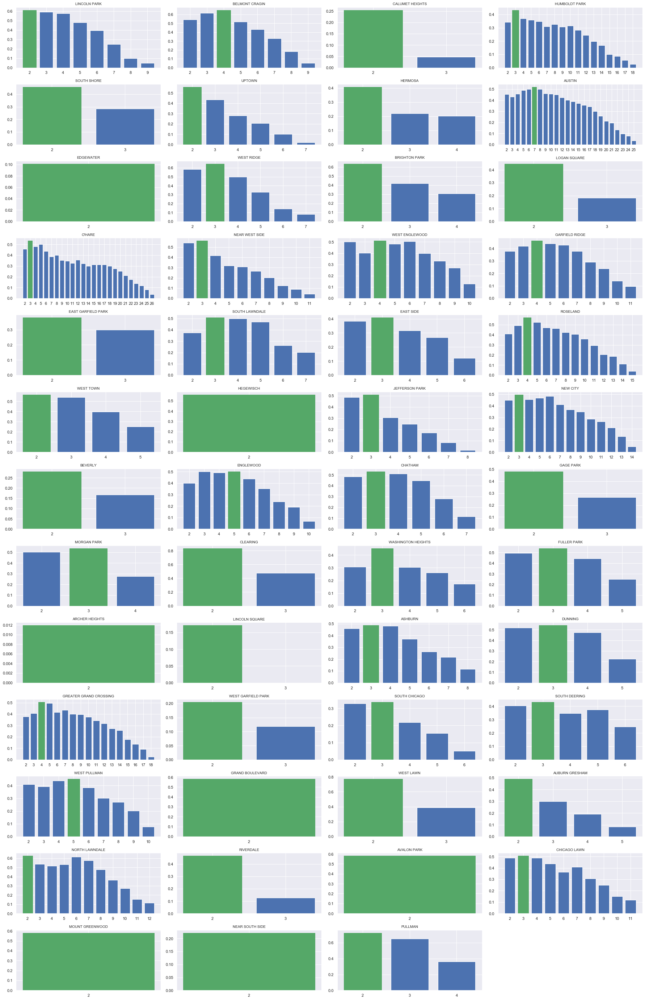

In [72]:
# model performance visualization of Silhouette score
from matplotlib import gridspec

N = len(clustering)
cols = 4
rows = int(math.ceil(N/cols))

gs = gridspec.GridSpec(rows, cols)
fig = plt.figure(figsize = (25,50))
n = 0
for key, val in clustering.items():
    if val['silhouette_vals'] is None:
        continue
    ax = fig.add_subplot(gs[n])
    labels = [str(x) for x in val['clusters']]
    barlist = ax.bar(labels, val['silhouette_vals'])
    optimal_cluster_bar_index = val['optimal']['clustersNumber'] - 2
    barlist[optimal_cluster_bar_index].set_color('g')
    ax.set_title(key, fontsize='10')
    # ax.set_ylim(top=1, bottom=0)
    n += 1

plt.tight_layout()
plt.savefig('silhouette_score.png', dpi=150)

In [73]:
# visualisation of clusters
chicago_map = folium.Map(location=[chg_area_lat_min + (chg_area_lat_max-chg_area_lat_min)/2, 
                                   chg_area_lng_min + (chg_area_lng_max-chg_area_lng_min)/2], 
                         zoom_start=10)
folium.GeoJson(geo_json, name='geojson').add_to(chicago_map)
folium.TileLayer('cartodbpositron').add_to(chicago_map)
HeatMap(df_area_candidate[['centroid_lat','centroid_lon']]).add_to(chicago_map)
Fullscreen().add_to(chicago_map)

for key, value in clustering.items():
    idx = 1
    for lon, lat in value['optimal']['clusterCenters']:
        popup_text = (key + ' ' + str(idx) + '/' + str(value["optimal"]["clustersNumber"]))
        """
        folium.Marker([lat, lon], 
                      popup=popup_text, 
                      icon=folium.Icon(color='blue', icon='info-sign')).add_to(chicago_map)
        """
        folium.Circle([lat, lon], radius=600, color='white', 
                      fill=True, fill_opacity=0.5, stroke=False,
                      popup=popup_text).add_to(chicago_map)
        idx += 1
chicago_map

Wrap up clustering results. It produced 158 clusters from 429 area candidates.

In [74]:
clusters = list()
for key, val in clustering.items():
    #if key != 'BELMONT CRAGIN':
    #    continue
    cluster_number = 0
    unique, counts = np.unique(val['optimal']['clusterLabels'], 
                               return_counts=True)
    area_count = dict(zip(unique, counts))
    #print(key, area_count)
    
    for it in val['optimal']['clusterCenters']:
        c = C(lon=it[0], lat=it[1])
        clusters.append({'id': '-'.join([z[0:3] for z in key.split()]) + '$' + str(cluster_number),
                         'community': key,
                         'cluster_number': cluster_number,
                         'area_count': area_count[cluster_number],
                         'lon':it[0], 'lat': it[1],
                         'x': c.x, 'y': c.y})
        cluster_number += 1
df_clusters = pd.DataFrame(clusters)
df_clusters_cartesian = cartesian_product_basic(df_clusters, df_clusters)
df_clusters_cartesian['distance'] = df_clusters_cartesian.apply(lambda row: math.sqrt((row.x_x - row.x_y)**2 + (row.y_x - row.y_y)**2) if row.id_x != row.id_y else None, axis=1)
# df_clusters[df_clusters['community'].isin(['LINCOLN PARK', 'ALBANY PARK'])]
df_clusters

,id,community,cluster_number,area_count,lon,lat,x,y
0,LIN-PAR$0,LINCOLN PARK,0,6,-87.639458,41.925573,446979.810667,4.641710e+06
1,LIN-PAR$1,LINCOLN PARK,1,4,-87.669676,41.931932,444479.802213,4.642436e+06
2,BEL-CRA$0,BELMONT CRAGIN,0,4,-87.746927,41.915715,438059.503561,4.640688e+06
3,BEL-CRA$1,BELMONT CRAGIN,1,3,-87.782986,41.930786,435084.496418,4.642388e+06
4,BEL-CRA$2,BELMONT CRAGIN,2,2,-87.755242,41.930522,437384.503245,4.642338e+06
...,...,...,...,...,...,...,...,...
153,NEA-SOU-SID$0,NEAR SOUTH SIDE,0,2,-87.633043,41.857883,447456.239119,4.634191e+06
154,NEA-SOU-SID$1,NEAR SOUTH SIDE,1,1,-87.606001,41.864784,449706.248905,4.634941e+06
155,BUR$0,BURNSIDE,0,1,-87.602824,41.729373,449864.475494,4.619905e+06
156,PUL$0,PULLMAN,0,2,-87.590930,41.716079,450843.559197,4.618422e+06


It is good but still insufficient, especially when it comes to review them one by one. Fortunately, this can be automated even more by using graph and longest path. This also explains the reason to keep one or two areas per community and make “imputed” clusters. Cluster radius is decided to be 600m. In order to build cluster group (a cluster of clusters) where they all have overlapped areas is solved by selecting pairs of previously obtained clusters with distance between their centers less than 1200m (radius x2).

In [75]:
df_clusters_cartesian = df_clusters_cartesian[df_clusters_cartesian.distance <= 1200] # TODO: get rid of magic number
print(df_clusters_cartesian.shape)
redundant_rows = list()
for idx, row in df_clusters_cartesian.iterrows():
    mirror_row_index = df_clusters_cartesian[(df_clusters_cartesian.id_x == row.id_y) & (df_clusters_cartesian.id_y == row.id_x)].index[0]
    mirror_row_count = redundant_rows.count(mirror_row_index)
    idx_count = redundant_rows.count(idx)
    if mirror_row_count == 0 and idx_count == 0:
        redundant_rows.append(mirror_row_index)

assert len(redundant_rows)*2 == df_clusters_cartesian.shape[0]

df_clusters_cartesian.drop(redundant_rows, inplace=True)

(196, 17)


In [76]:
cluster_id = df_clusters_cartesian.id_x.to_list()
cluster_id.extend(df_clusters_cartesian.id_y.to_list())
cluster_id = list(set(cluster_id))
df_cluster_id = pd.DataFrame(cluster_id).reset_index().rename({'index':'cluster_graph_id', 0:'id'}, axis=1)
df_cluster_map = pd.merge(df_clusters_cartesian[['id_x', 'id_y']], df_cluster_id, how='inner', left_on='id_x', right_on='id')
df_cluster_map.drop('id', axis=1, inplace=True)
df_cluster_map = pd.merge(df_cluster_map, df_cluster_id, how='inner', left_on='id_y', right_on='id')
df_cluster_map.drop('id', axis=1, inplace=True)
df_cluster_map.head()

,id_x,id_y,cluster_graph_id_x,cluster_graph_id_y
0,LIN-PAR$1,LAK-VIE$0,80,4
1,LIN-PAR$1,LAK-VIE$1,80,73
2,LAK-VIE$0,LAK-VIE$1,4,73
3,BEL-CRA$0,HER$0,86,27
4,HUM-PAR$0,HER$0,15,27


In [77]:
# union and map to the longest path vertices groups
import re
df_cluster = df_clusters_cartesian[['id_y', 'community_y', 'cluster_number_y', 'area_count_y','lon_y','lat_y','x_y','y_y']]
df_cluster = df_cluster.rename(columns=lambda x: re.sub('_y$','_x',x))
df_cluster = df_clusters_cartesian[['id_x', 'community_x', 'cluster_number_x', 'area_count_x','lon_x','lat_x','x_x','y_x']].append(df_cluster)
df_cluster.drop_duplicates(inplace=True)
df_cluster = pd.merge(df_cluster, df_cluster_id, how='inner', left_on='id_x', right_on='id')
df_cluster.drop('id', axis=1, inplace=True)
df_cluster = df_cluster.rename(columns=lambda x: re.sub('_x$','',x))

assert len(df_cluster.cluster_graph_id.unique().tolist()) == len(cluster_id)
df_cluster.head()

,id,community,cluster_number,area_count,lon,lat,x,y,cluster_graph_id
0,LIN-PAR$1,LINCOLN PARK,1,4,-87.669676,41.931932,444479.802213,4.642436e+06,80
1,BEL-CRA$0,BELMONT CRAGIN,0,4,-87.746927,41.915715,438059.503561,4.640688e+06,86
2,BEL-CRA$3,BELMONT CRAGIN,3,1,-87.776770,41.915517,435584.503290,4.640688e+06,39
3,CAL-HEI$0,CALUMET HEIGHTS,0,2,-87.568766,41.736660,452702.386875,4.620695e+06,100
4,HUM-PAR$0,HUMBOLDT PARK,0,6,-87.731039,41.908439,439370.210588,4.639869e+06,15


In [78]:
# !conda install -c conda-forge python-igraph
from igraph import *

Corresponding graph is shown below. For instance, edges with labels 89, 1, 16 form a cluster of clusters with some underlying 300x300m areas.

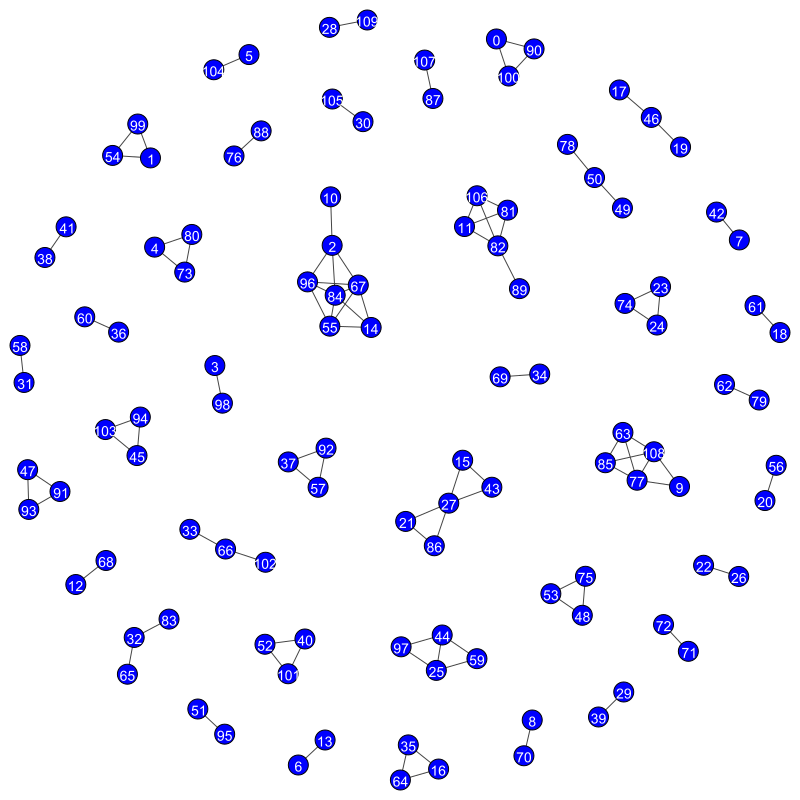

In [79]:
g = Graph()
g.add_vertices(len(cluster_id))
for idx, row in df_cluster_map[['cluster_graph_id_x', 'cluster_graph_id_y']].iterrows():
    g.add_edges([(row.cluster_graph_id_x, row.cluster_graph_id_y)])
# summary(g)
# g.vs["name"] = df_clusters.id.to_list()
g.vs["label"] = list(range(0, len(cluster_id)+1))
plot(g, layout='fr', bbox=(800, 800), margin = 20, vertex_color='blue', 
     vertex_size=20, vertex_label_color='white', inline=True)

In [80]:
def get_unique_values(l:list) -> list:
    s = set()
    for it in [*l]:
        s.add(it)
    return list(s)

cluster_paths = list()
processed_vertices = list()

for v in g.vs["label"]:
    l = list()
    l.extend(tuple(sorted(path)) for path in g.get_all_simple_paths(v))
    already_processed = False
    unique_values = get_unique_values(l)
    for it in unique_values:
        if it in processed_vertices:
            already_processed = True
            break
    
    if already_processed:
        continue
    else:
        # find the longest path within connected chain of vertices
        l.sort(key=len)
        cluster_paths.append(l[-1])
        processed_vertices.extend(unique_values)

# get longest 10 chains
cluster_paths = sorted(list(set(cluster_paths)), key=len)
# cluster_paths[-10:]

All characteristics are composed into single data frame, including cluster group size and number of areas included

In [81]:
cluster_groups = list()
for idx, val in enumerate(cluster_paths):
    for it in val:
        cluster_groups.append({'cluster_group':idx, 'cluster_graph_id': it, 'group_size': len(val)})
df_cluster_groups = pd.DataFrame(cluster_groups)
df_cluster = pd.merge(df_cluster, df_cluster_groups, how='inner', on='cluster_graph_id')
df_cluster

,id,community,cluster_number,area_count,lon,lat,x,y,cluster_graph_id,cluster_group,group_size
0,LIN-PAR$1,LINCOLN PARK,1,4,-87.669676,41.931932,444479.802213,4.642436e+06,80,27,3
1,BEL-CRA$0,BELMONT CRAGIN,0,4,-87.746927,41.915715,438059.503561,4.640688e+06,86,38,5
2,BEL-CRA$3,BELMONT CRAGIN,3,1,-87.776770,41.915517,435584.503290,4.640688e+06,39,4,2
3,CAL-HEI$0,CALUMET HEIGHTS,0,2,-87.568766,41.736660,452702.386875,4.620695e+06,100,26,3
4,HUM-PAR$0,HUMBOLDT PARK,0,6,-87.731039,41.908439,439370.210588,4.639869e+06,15,38,5
...,...,...,...,...,...,...,...,...,...,...,...
103,LIN-SQU$1,LINCOLN SQUARE,1,2,-87.677820,41.981499,443848.169430,4.647944e+06,71,21,2
104,MON$1,MONTCLARE,1,1,-87.805349,41.930526,433230.131747,4.642376e+06,35,31,3
105,LOW-WES-SID$1,LOWER WEST SIDE,1,1,-87.665280,41.852796,444776.156886,4.633646e+06,95,8,2
106,WES-PUL$4,WEST PULLMAN,4,1,-87.640564,41.674074,446680.026289,4.613788e+06,89,36,5


Top 3 cluster groups by number of clusters are considered further as more beneficial from area coverage and a strong indicator of an optimal location. OpenCage API was used to retrieve more human readable address by geospatial coordinates. 26 areas instead of 429 within 5 cluster groups

In [82]:
top_rank_cluster_group_size = 3
def lonlat_to_address(lon:float, lat:float)->str:
    lat_lon = ','.join([str(lat), str(lon)])
    url = 'https://api.opencagedata.com/geocode/v1/json?key={}&q={}&language=en&limit=1&no_annotations=1&no_dedupe=0'.format(opencagedata_api_token, lat_lon)
    address_json = requests.get(url).json()
    return get_first("$.results[*].formatted", address_json)

best_cluster_file = 'best_cluster_file.csv'

if path.exists(best_cluster_file):
    # load data from already composed file
    df_best_cluster = pd.read_csv(best_cluster_file, sep='|')
    # df_best_cluster.drop('index', axis=1, inplace=True)
else:
    df_best_cluster = df_cluster[df_cluster.group_size.isin(sorted(df_cluster.group_size.unique().tolist())[-top_rank_cluster_group_size:])].copy(deep=True)
    address = list()
    for idx, row in df_best_cluster.iterrows():
        cluster_center_address = lonlat_to_address(lon=row.lon, lat=row.lat)
        if cluster_center_address is not None:
            cluster_center_address = cluster_center_address.replace(', United States of America', '')
            address.append(cluster_center_address)
        else:
            address.append(None)
    df_best_cluster['address'] = address
    # store data to file
    df_best_cluster.to_csv(best_cluster_file, sep='|', index=False)

# ranking
df_best_cluster.sort_values(by=['group_size', 'cluster_group', 'area_count'], ascending=[False, True, False], inplace=True)
df_best_cluster.reset_index(drop=True, inplace=True)
df_best_cluster.head(50)

,id,community,cluster_number,area_count,lon,lat,x,y,cluster_graph_id,cluster_group,group_size,address
0,WES-PUL$1,WEST PULLMAN,1,4,-87.619939,41.684320,448405.031975,4.614913e+06,57,39,7,"120 East Kensington Avenue, Chicago, IL 60628"
1,ROS$2,ROSELAND,2,3,-87.617933,41.685286,448572.758391,4.615019e+06,98,39,7,"St. John M.B. Church, 205-221 East 115th Stree..."
2,PUL$1,PULLMAN,1,3,-87.609929,41.691210,449243.567434,4.615672e+06,31,39,7,"Pullman National Monument Visitors Center, 111..."
3,WES-PUL$3,WEST PULLMAN,3,3,-87.618941,41.674193,448480.022077,4.613788e+06,78,39,7,"12105 South Edbrooke Avenue, Chicago, IL 60628"
4,RIV$0,RIVERDALE,0,2,-87.612131,41.684248,449054.805200,4.614901e+06,21,39,7,"470 East Kensington Avenue, Chicago, IL 60628"
5,RIV$1,RIVERDALE,1,2,-87.604922,41.684286,449654.805199,4.614901e+06,70,39,7,"690 East Kensington Avenue, Chicago, IL 60628"
6,SOU-DEE$2,SOUTH DEERING,2,1,-87.600809,41.683276,449996.352685,4.614786e+06,13,39,7,"South Doty Avenue, Chicago, IL 60633"
7,ROS$3,ROSELAND,3,5,-87.639394,41.692735,446792.768713,4.615859e+06,14,36,5,"644 West 111th Street, Chicago, IL 60643"
8,MOR-PAR$0,MORGAN PARK,0,2,-87.645654,41.693344,446272.418692,4.615931e+06,25,36,5,"11023 South Sangamon Street, Chicago, IL 60643"
9,MOR-PAR$2,MORGAN PARK,2,2,-87.643784,41.686599,446422.418626,4.615181e+06,41,36,5,"800-900 West 115th Street, Chicago, IL 60643"


In [83]:
# visualizing five cluster groups
chicago_map = folium.Map(location=[chg_area_lat_min + (chg_area_lat_max-chg_area_lat_min)/2, 
                                   chg_area_lng_min + (chg_area_lng_max-chg_area_lng_min)/2], 
                         zoom_start=10)
folium.GeoJson(geo_json, name='geojson').add_to(chicago_map)
Fullscreen().add_to(chicago_map)

for idx, row in df_best_cluster.iterrows():
    popup_text = str(row['cluster_group']) + ' / ' + str(row['group_size']) + ' / ' +row['id'] + ' : ' + row['address']
    
    folium.Marker([row.lat, row.lon], 
                  popup=popup_text, 
                  icon=folium.Icon(color='green')).add_to(chicago_map)
    
    folium.Circle([row.lat, row.lon], radius=600, color='grey', 
                  fill=True, fill_opacity=0.5, stroke=False,
                  popup=popup_text).add_to(chicago_map)
chicago_map

For the obtained best clusters run foursquare exploration to find relevant venue categories to open a new gym

In [84]:
location_pattern = '^(?!.*(government|capitol|college)).*(building|(coworking.{0,}space)|(business.{0,}center)|(rehab.{0,}center))'
location_categories = get_categories(location_pattern)
df_categories[df_categories['id'].isin(location_categories.split(','))]

C:\Users\USER\anaconda3\lib\site-packages\pandas\core\strings.py:1952: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  return func(self, *args, **kwargs)


,name,id,immediateParentId,ultimateeParentId,category
604,Building,4bf58dd8d48988d130941735,4d4b7105d754a06375d81259,4d4b7105d754a06375d81259,None
605,Business Center,56aa371be4b08b9a8d573517,4d4b7105d754a06375d81259,4d4b7105d754a06375d81259,public places
647,Rehab Center,56aa371be4b08b9a8d57351d,4bf58dd8d48988d104941735,4d4b7105d754a06375d81259,None
660,Coworking Space,4bf58dd8d48988d174941735,4bf58dd8d48988d124941735,4d4b7105d754a06375d81259,None
711,Residential Building (Apartment / Condo),4d954b06a243a5684965b473,4e67e38e036454776db1fb3a,4e67e38e036454776db1fb3a,residence


In [85]:
df_optimal_venues = pd.DataFrame()
radius = 600
pbar = tqdm()
pbar.reset(total=df_best_cluster.shape[0])

optimal_venues_file = 'optimal_venues_file.csv'


if path.exists(optimal_venues_file):
    # load data from already composed file
    df_optimal_venues = pd.read_csv(optimal_venues_file, sep='|')
else:
    for idx, row in df_best_cluster.iterrows():
        pbar.update()
        # print(f"retrieveing venues for cluster {row['id']}")
        ll=str(row['lat']) + ',' + str(row['lon'])
        url = 'https://api.foursquare.com/v2/venues/search?{}&limit=50&categoryId={}&intent=browse&ll={}&radius={}'.format(token_str_userless, location_categories, ll, radius)
        try:
            results = requests.get(url).json()
            parsed_data = extract_venues(results, 
                                         category_name='location', 
                                         extract_formatted_address=True)
        except Exception as e:
            print(f"failed to retrieve venues for cluster {row['id']}")
        else:
            if len(parsed_data) > 0:
                df = pd.DataFrame(parsed_data)
                df['cluster_id'] = row['id']
                df['cluster_group'] = row['cluster_group']
                df_optimal_venues = df_optimal_venues.append(df)
            time.sleep(1)

    if df_optimal_venues.shape[0] > 0:
        df_optimal_venues.drop_duplicates(subset=['cluster_group', 'id'], inplace=True)
        df_optimal_venues.reset_index(drop=True, inplace=True)

        # filter out by name venues to cover data quality gap
        df_optimal_venues.drop(df_optimal_venues[df_optimal_venues.name.str.contains('church|catholic|villa|(rail.{0,}yard)', False)].index,
                               axis=0, inplace=True)
        df_optimal_venues.reset_index(drop=True, inplace=True)
        addresses = df_optimal_venues.formatted_address.apply(lambda x: ','.join([it for it in x if it != 'United States']))
        print(f'addresses retrieved throug the Foursquare Places API: {addresses.to_list()[:5]}')

        # resolve addresses throug 
        venue_addresses = list()
        for idx, row in df_optimal_venues.iterrows():
            venue_address = lonlat_to_address(lon=row.lng, lat=row.lat)
            if venue_address is not None:
                venue_address = venue_address.replace(', United States of America', '')
                venue_addresses.append(venue_address)
            else:
                venue_addresses.append(None)

        print(f'addresses retrieved throug the Opencagedata API: {venue_addresses[:5]}')
        df_optimal_venues.formatted_address = venue_addresses

        # filter more venues by the same criteria
        df_optimal_venues.drop(df_optimal_venues[df_optimal_venues.formatted_address.str.contains('church|catholic|villa|(rail.{0,}yard)', False)].index,
                               axis=0, inplace=True)
        df_optimal_venues.reset_index(inplace=True, drop=True)
        df_optimal_venues = df_optimal_venues[['id', 'lat', 'lng', 'formatted_address', 'cluster_id', 'cluster_group']]

    df_optimal_venues.to_csv(optimal_venues_file, sep='|', index=False)

df_optimal_venues.head(10)

,id,lat,lng,formatted_address,cluster_id,cluster_group
0,4f7c5dc6e4b032c26c42aad2,41.681278,-87.617058,"11634 South Prairie Avenue, Chicago, IL 60628",WES-PUL$1,39
1,4f7c98a4e4b086fa1f31b394,41.689148,-87.620651,"108-112 East 113th Street, Chicago, IL 60628",WES-PUL$1,39
2,4f8c2f21e4b0c71a74483d18,41.684486,-87.617729,"218-224 East Kensington Avenue, Chicago, IL 60628",WES-PUL$1,39
3,4c21fc299390c9b649c0c9cd,41.690792,-87.604322,"Comcast, 11201-11203 South Ellis Avenue, Chica...",PUL$1,39
4,5197a4ee498e820998bda70d,41.694714,-87.606482,"The University of Chicago Press, 11030 South L...",PUL$1,39
5,4de177ef7d8b2547eaed0c5d,41.689927,-87.604198,"Raffin, 734-744 East 113th Street, Chicago, IL...",PUL$1,39
6,4c094055a1b32d7f7c5897f0,41.677610,-87.620831,"11912 South Michigan Avenue, Chicago, IL 60628",WES-PUL$3,39
7,4e475e47fa76a07fde675d62,41.673782,-87.616482,"224-228 East 121st Place, Chicago, IL 60628",WES-PUL$3,39
8,4c0940c66071a593fc95dd32,41.676058,-87.620742,"12006 South Michigan Avenue, Chicago, IL 60628",WES-PUL$3,39
9,4bd6d905cfa7b7131d2028da,41.680777,-87.609952,"Chicago, IL 60627",RIV$0,39


In [86]:
df_optimal_venues.shape

(65, 6)

In [87]:
# add optimal venues to the map with cluster groups 
for idx, row in df_optimal_venues.iterrows():
    popup_text = row['formatted_address']
    
    folium.Marker([row.lat, row.lng], 
                  popup=popup_text, 
                  icon=folium.Icon(color='blue')).add_to(chicago_map)
    
chicago_map

---

## Results and Discussion <a name="results"></a>

* 24K venues of six different categories were analyzed
* Chicago area was split on 8.5K 300x300m areas for detailed analysis
* Impact factors are analyzed: gym venue location is mostly influenced by nearby transport-related venues
* Answers to address business problem are:


In [88]:
# Optimal location adress
pd.set_option('display.max_colwidth', 500)
df_best_cluster.sort_values(by=['community', 'address'])[['community', 'address']]

,community,address
13,ASHBURN,"Coc Water South District Headquarters, 7501-7521 South Western Avenue, Chicago, IL 60643"
12,AUBURN GRESHAM,"7711 South Wolcott Avenue, Chicago, IL 60620"
20,AUSTIN,"4900 West Bloomingdale Avenue, Chicago, IL 60639"
18,BELMONT CRAGIN,"1923 North La Crosse Avenue, Chicago, IL 60639"
15,CHICAGO LAWN,"7410-7426 South Western Avenue, Chicago, IL 60643"
23,ENGLEWOOD,"638-640 West Garfield Boulevard, Chicago, IL 6069"
25,FULLER PARK,"4914 South Wells Street, Chicago, IL 6069"
24,FULLER PARK,"Conrail 51st Street Freight House, West 51st Street, Chicago, IL 60632"
19,HERMOSA,"4218 West Armitage Avenue, Chicago, IL 60639"
21,HERMOSA,"4700 West Grand Avenue, Chicago, IL 60651"


In [89]:
# Suggested venues to open a gym 
pd.set_option('display.max_rows', 500)
pd.merge(df_optimal_venues, df_best_cluster[['id', 'community']], how='inner', left_on='cluster_id', right_on='id')[['community', 'formatted_address']].sort_values(by=['community','formatted_address'])

,community,formatted_address
22,AUBURN GRESHAM,"7511 South Damen Avenue, Chicago, IL 60620"
23,AUBURN GRESHAM,"7906-7910 South Hermitage Avenue, Chicago, IL 60620"
57,AUSTIN,"5012 West Concord Place, Chicago, IL 60639"
56,AUSTIN,"BMO Harris Bank, 4959 West North Avenue, Chicago, IL 60639"
45,BELMONT CRAGIN,"4545-4555 West Armitage Avenue, Chicago, IL 60639"
42,BELMONT CRAGIN,"4712 West Armitage Avenue, Chicago, IL 60639"
44,BELMONT CRAGIN,"4901-4915 West Armitage Avenue, Chicago, IL 60639"
41,BELMONT CRAGIN,"5000-5008 West Bloomingdale Avenue, Chicago, IL 60639"
43,BELMONT CRAGIN,"5008-5010 West Dickens Avenue, Chicago, IL 60639"
64,FULLER PARK,"4749 South Wentworth Avenue, Chicago, IL 60621"


---

## Discussion <a name="discussion"></a>

Although business problem was addressed, following areas can be improved:
* area center calculation
* consequent area coverage by the grid
* grid to exclude irrelevant areas where a venue cannot be located
* reduce number of venues in the "areas, venues" cartesian product, by filtering out all venues located further than 5km either by x or y coordinate
* analyze which venue categories are currently occupied by competitors and use those for finding optimal location
* make transport category more granular, probably by reducing it to the following venues: private and public transport; embarkation, dis-embarkation train stations/hubs.
* apply PCA, make use of demographics data
* notebook code refactoring

---

## Conclusion <a name="conclusion"></a>

In this study I identified optimal location for opening a gym in Chicago, IL. I analyzed impact factors on having a gym venue and their correlation with demographics data. Optimal locations can be very useful for anyone real estate agencies or gym/fitness business owners, allowing them to save a lot of time and choose from optimal locations prepared with the power of machine learning. Also, existing approach is highly customizable and can be applied for different venue type or even different location with minimal changes.

---